# 모듈

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import random

# 한글 깨짐 방지
import koreanize_matplotlib

#Time Series Analysis
import statsmodels.api as sm
from statsmodels.tsa.stattools import adfuller, kpss, ccf
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.deterministic import DeterministicProcess

# clustering
from sklearn.cluster import KMeans

# 모델링
from statsmodels.tsa.arima.model import ARIMA
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
from catboost import CatBoostRegressor
from sklearn.tree import ExtraTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import KFold
from sklearn.metrics import mean_absolute_error
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_squared_error
from sktime.forecasting.model_selection import temporal_train_test_split
from sktime.utils.plotting import plot_series

# 시스템
from tqdm.notebook import tqdm
import os
import warnings
warnings.filterwarnings('ignore')

In [2]:
# 시드 고정
def seed_everything(seed):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)

seed_everything(42)

# 데이터 불러오기

In [3]:
train = pd.read_csv('./데이터/train.csv', encoding='cp949')
test = pd.read_csv('./데이터/test.csv', encoding='cp949')
sub = pd.read_csv('./데이터/sample_submission.csv', encoding='cp949')

# feature 이름 변경

In [4]:
train.columns = ['건물번호', '시간', '전력사용량', '기온','풍속', '습도', '강수량', '일조', '비전기냉방설비운영', '태양광보유']
test.columns = ['건물번호', '시간', '기온', '풍속', '습도', '강수량', '일조', '비전기냉방설비운영', '태양광보유']

# 결측치 처리

## 비전기냉방설비, 태양광보유 결측치 처리

In [5]:
building_info = train[['건물번호','비전기냉방설비운영', '태양광보유']].drop_duplicates()

test.drop(['비전기냉방설비운영', '태양광보유'], axis=1, inplace = True)
test = pd.merge(test, building_info, on= '건물번호')

## 기온, 풍속, 습도, 강수량 결측치 처리

In [6]:
# train 임의의 결측치 만들기
train_ = train.copy()
def make_train_nan(col, n):
    new_list = []
    for idx, temp in enumerate(train_[col]):
        if idx%n==0:
            new_list.append(temp)
        else:
            new_list.append(np.nan)
    train_['{}'.format(col+'_nan')] = new_list


make_train_nan('기온',3)
make_train_nan('풍속',3)
make_train_nan('습도',3)
make_train_nan('강수량',6)

print(train_.iloc[:,-4:].isnull().sum())

기온_nan      81600
풍속_nan      81600
습도_nan      81600
강수량_nan    102000
dtype: int64


In [7]:
def compare_interpolate_methods(col, methods, metric):
    error_dict = dict()
    for method in methods:
        fillna = train_['{}'.format(col+'_nan')].interpolate(method=method)
        if fillna.isna().sum() != 0:
            fillna = fillna.interpolate(method='linear')
        error = metric(train_['{}'.format(col)], fillna)
        error_dict['{}'.format(method)] = error
    
    return error_dict

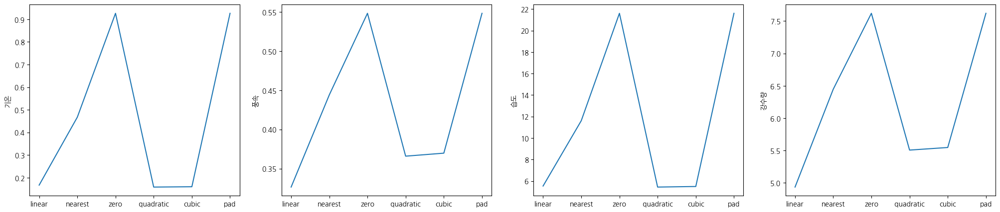

In [8]:
all_cols_error_dict = dict()
for col in ['기온', '풍속', '습도', '강수량']:
    methods = ['linear', 'nearest', 'zero', 'quadratic', 'cubic', 'pad']
    error_dict = compare_interpolate_methods(col, methods, mean_squared_error)
    all_cols_error_dict['{}'.format(col)] = error_dict
    
all_cols_error_df = pd.DataFrame(all_cols_error_dict)

fig, axes = plt.subplots(1,4, figsize = (25,5), sharey=False)
for i in range(len(all_cols_error_df.columns)):
    sns.lineplot(ax=axes[i], data=all_cols_error_df.iloc[:,i].transpose())

In [9]:
#기온 결측치 채우기
test['기온'] = test['기온'].interpolate(method='quadratic')
#마지막 na 채우기
test['기온'] = test['기온'].interpolate(method='linear')

#풍속 결측치 채우기
test['풍속'] = test['풍속'].interpolate(method='linear')

#습도 결측치 채우기
test['습도'] = test['습도'].interpolate(method='quadratic')
#마지막 na 채우기
test['습도'] = test['습도'].interpolate(method='linear')

#강수량 결측치 채우기
test['강수량'] = test['강수량'].interpolate(method='linear')

test['일조'] = test['일조'].interpolate(method='pad')

In [10]:
# 일조 최대값 3이기 때문에 minmax 진행
def scale_column(column):
    min_val = column.min()
    max_val = column.max()
    scaled_column = (column - min_val) / (max_val - min_val)
    return scaled_column

test['일조'] = scale_column(test['일조'])

# 이상치 처리

## 9, 25, 27번 이상치 처리

In [11]:
# 9번
train[(train['건물번호']==9) & (train['전력사용량']<1000)];
train.loc[16374,'전력사용량'] = (1200 + 1251.180) / 2
train.loc[16375,'전력사용량'] = (1200 + 1255.176) / 2
train.loc[16376,'전력사용량'] = (1200 + 1249.668) / 2
train.loc[16377,'전력사용량'] = (1200 + 1234.332) / 2
train.loc[16378,'전력사용량'] = (1200 + 1199.556) / 2
train.loc[16379,'전력사용량'] = (1200 + 1204.524) / 2
train.loc[16380,'전력사용량'] = (1200 + 1196.748) / 2
train.loc[16381,'전력사용량'] = (1200 + 1186.704) / 2
train.loc[16382,'전력사용량'] = (1200 + 1187.028) / 2
train.loc[16383,'전력사용량'] = (1200 + 1197.396) / 2
train.loc[16402,'전력사용량'] = (1200 + 1256.472) / 2
train.loc[17407,'전력사용량'] = (1302.156 + 1285.848) / 2
train.loc[17408,'전력사용량'] = (1289.844 + 1287.144) / 2
train.loc[17409,'전력사용량'] = (1264.356 + 1294.056) / 2
train.loc[17410,'전력사용량'] = (1250.316 + 1304.424) / 2
train.loc[17411,'전력사용량'] = (1255.392 + 1293.732) / 2
train.loc[17412,'전력사용량'] = (1248.804 + 1291.032) / 2
train.loc[17413,'전력사용량'] = (1253.664 + 1299.564) / 2
train.loc[17414,'전력사용량'] = (1257.552 + 1302.588) / 2
train.loc[17415,'전력사용량'] = (1270.944 + 1305.504) / 2
train.loc[17416,'전력사용량'] = (1326.024 + 1310.580) / 2
train.loc[17530,'전력사용량'] = (1285.416 + 1314.468) / 2
train.loc[17531,'전력사용량'] = (1279.692000 + 1317.708000) / 2
train.loc[17532,'전력사용량'] = (1276.884000 + 1278.828000) / 2
train.loc[17533,'전력사용량'] = (1287.252000 + 1280.124000) / 2

# 25번
train[(train['건물번호']==25) & (train['전력사용량']<500)];
train.loc[49954,'전력사용량'] = (1270.080 + 1041.984) / 2
train.loc[49955,'전력사용량'] = (1257.768 + 1039.392) / 2

# 27번
train[(train['건물번호']==27) & (train['전력사용량']<100)];
train.loc[54684,'전력사용량'] = (241.38 + 439.02) / 2
train.loc[54685,'전력사용량'] = (541.35 + 460.35) / 2
train.loc[54686,'전력사용량'] = (564.03 + 582.93) / 2
train.loc[54687,'전력사용량'] = (588.06 + 561.06) / 2
train.loc[54688,'전력사용량'] = (615.06 + 540.27) / 2
train.loc[55044,'전력사용량'] = (368.01 + 235.44) / 2

## 31, 33, 36번 이상치 처리

In [12]:
def power_mean(index1, index2, target) :
    val1 = train.loc[index1, '전력사용량']
    val2 = train.loc[index2, '전력사용량']
    power_avg = round(np.mean([val1, val2]), 3)
    train.loc[target, '전력사용량'] = power_avg

# 31번 건물
power_mean(61289, 61625, 61457)

# 33번 건물
power_mean(65369, 65705, 65537)

# 36번 건물
# 6월 19일 6시
power_mean(71670, 72006, 71838)

# 8월 12일 5~8시
power_mean(72965, 73301, 73133)
power_mean(72966, 73302, 73134)
power_mean(72967, 73303, 73135)
power_mean(72967, 73304, 73136)

## 45, 55, 60번 건물 이상치 처리

In [13]:
# 45번 건물
train.loc[90577,'전력사용량'] = (train.loc[90409,'전력사용량'] + train.loc[90745,'전력사용량']) / 2

# 55번 건물
train.loc[111802,'전력사용량'] = (train.loc[111634,'전력사용량'] + train.loc[111970,'전력사용량']) / 2
train.loc[111803,'전력사용량'] = (train.loc[111635,'전력사용량'] + train.loc[111971,'전력사용량']) / 2
train.loc[111808,'전력사용량'] = (train.loc[111640,'전력사용량'] + train.loc[111976,'전력사용량']) / 2
train.loc[111809,'전력사용량'] = (train.loc[111641,'전력사용량'] + train.loc[111977,'전력사용량']) / 2

# 60번 건물
train.loc[121081,'전력사용량'] = (train.loc[120913,'전력사용량'] + train.loc[121249,'전력사용량']) / 2

## 이상치 변경 확인

In [14]:
# # 고유한 건물번호 추출
# building_numbers = train['건물번호'].unique()

# # 건물번호별로 그래프 그리기
# fig, axes = plt.subplots(len(building_numbers), 1, figsize=(15, 6*len(building_numbers)), sharex=True)

# for i, building_number in enumerate(building_numbers):
#     building_data = train[train['건물번호'] == building_number]
#     axes[i].plot(building_data['시간'], building_data['전력사용량'])
#     axes[i].set_xlabel('시간')
#     axes[i].set_ylabel('전력사용량')
#     axes[i].set_title(f'건물번호 {building_number} 전력사용량')

# feature engineering

## 시간

In [15]:
train['시간'] = pd.to_datetime(train['시간'])
test['시간'] = pd.to_datetime(test['시간'])

In [16]:
def datetime_chage(df):
    # 5, 6 주말
    df['date'] = df['시간'].dt.date
    df['date'] = pd.to_datetime(train['date'])
    df['month'] = df['시간'].dt.month
    df['hour'] = df['시간'].dt.hour
    df['weekday'] = df['시간'].dt.weekday
    df['day'] = df['시간'].dt.day

    # hour는 0~23이기 때문에 비슷한 시간이여도 멀게 느껴지기 때문에 sin, cosine 함수를 활용해 변환하여 순환적인 성격을 반영한다.
    df['sin_time'] = np.sin(2*np.pi*train.hour/24)
    df['cos_time'] = np.cos(2*np.pi*train.hour/24)

datetime_chage(train)
datetime_chage(test)

In [17]:
# 공휴일 변수 추가
train['holiday'] = train.apply(lambda x : 0 if x['weekday']<5 else 1, axis = 1)
test['holiday'] = test.apply(lambda x : 0 if x['weekday']<5 else 1, axis = 1)

# 실제 달력보면 2020-08-17이 임시공휴일임 -> holiday를 1로 바꿈
train['date'] = pd.to_datetime(train['date'])
train.loc[('2020-08-17'<=train.date)&(train.date<'2020-08-18'), 'holiday'] = 1

## 냉방도일

In [18]:
# 냉방도일 파생변수 추가
# 냉방도일 : 일평균 기온 24℃ 이상의 값에 대한 1년간의 적산 온도를, 도일수(degree day)를 단위로 하여 나타낸 것
# 도일(degree day): 외부 기온과 실내 기온의 차와 이에 따라 소요되는 연료 소비를 고려한 기후 수치
# 냉방기준 온도가 26도이기 때문에 -> 에너지 절약, 건강 차원
# 도일의 특징
# - 1. 도일이 크면 연료의 소비량은 많아지고, 작을수록 연료의 소비량은 적어진다.
# - 2. 도일은 그 지방의 연료 소비량을 추정할 수 있지만 설비용량은 정확하게 산출 불가다.
# - 3. 도일은 실내온도가 같아도 외기온도가 다르기 때문에 지역마다 그 값은 다르게 나타난다.


def CDH(xs):
    ys = []
    for i in range(len(xs)):
        if i < 11:
            ys.append(np.sum(xs[:(i+1)]-26))
        else:
            ys.append(np.sum(xs[(i-11):(i+1)]-26))
    return np.array(ys)

cdhs = np.array([])
for num in range(1,61,1):
    temp = train[train['건물번호'] == num]
    cdh = CDH(temp['기온'].values)
    cdhs = np.concatenate([cdhs, cdh])
train['CDH'] = cdhs

cdhs = np.array([])
for num in range(1,61,1):
    temp = test[test['건물번호'] == num]
    cdh = CDH(temp['기온'].values)
    cdhs = np.concatenate([cdhs, cdh])
test['CDH'] = cdhs

## 체감온도

In [19]:
def Perceived_Temp(df):
    df['습구온도'] = df['기온'] * np.arctan(0.151977*((df['습도']+8.313659)**(1/2))) + np.arctan(df['기온']+df['습도']) - np.arctan(df['습도']-1.67633) + 0.00391838*(df['습도']**(3/2))*np.arctan(0.023101*df['습도']) - 4.686035
    df['체감온도'] = -0.2442 + 0.55399 * df['습구온도'] + 0.45535 * df['기온'] - 0.0022 * (df['습구온도'] ** 2) + 0.00278 * df['습구온도'] * df['기온'] + 3.0

Perceived_Temp(train)
Perceived_Temp(test)

## 불쾌지수

In [20]:
def THI_func(df):
    df['불쾌지수'] = 1.8 * df['기온'] - 0.55*(1-df['습도'])*(1.8*df['기온']-26)+32
THI_func(train)
THI_func(test)

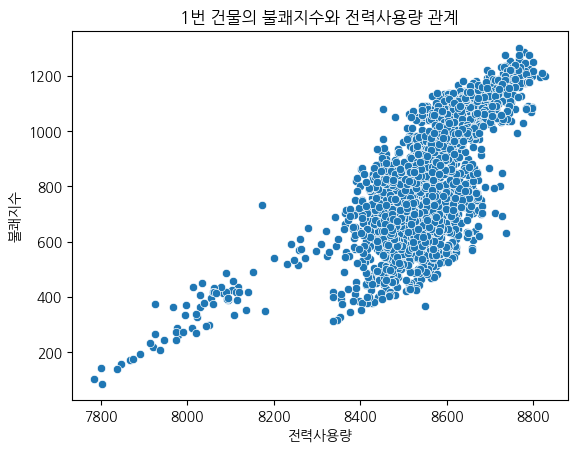

In [21]:
sns.scatterplot(data=train[train['건물번호']==1], x='전력사용량', y='불쾌지수')
plt.title('1번 건물의 불쾌지수와 전력사용량 관계')
plt.show()

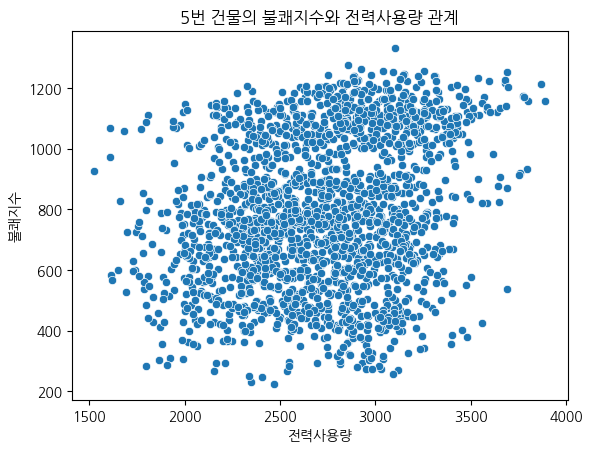

In [22]:
sns.scatterplot(data=train[train['건물번호']==5], x='전력사용량', y='불쾌지수')
plt.title('5번 건물의 불쾌지수와 전력사용량 관계')
plt.show()

# 시계열 분석

## 시계열 분해
- 시계열 분해를 통해 건물별 전력사용량을 추세, 계절성, 잔차로 분해

In [23]:
def vis_time_series_decompose(num):
    df = train[train.건물번호==num]
    df.index = df.시간

    res = sm.tsa.seasonal_decompose(df['전력사용량'], model='additive')

    fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(20, 12))
    res.observed.plot(ax=ax1, title='Observed')
    res.trend.plot(ax=ax2, title='Trend')
    res.resid.plot(ax=ax3, title='Residual')
    res.seasonal.plot(ax=ax4, title='Seasonal')
    plt.tight_layout()
    plt.show()

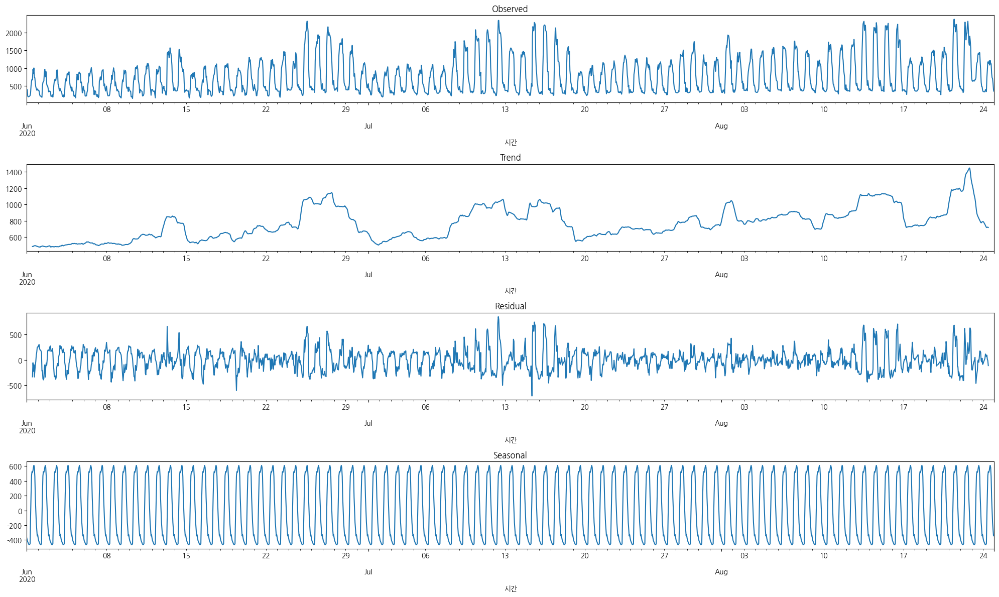

In [24]:
## 건물4
vis_time_series_decompose(num=4)

# 건물4의 경우, 하루를 주기로 계절성을 지님을 알 수 있습니다. 또한 85일동안 특별히 증가하거나 감소하는 추세는 보이지 않습니다.

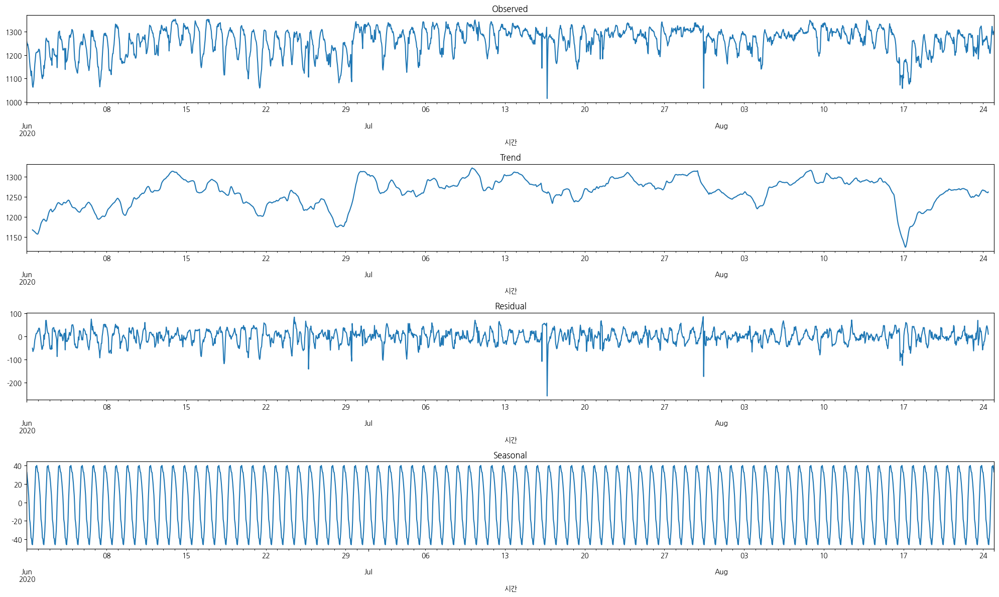

In [25]:
## 건물9
vis_time_series_decompose(num=9)

# 건물9의 경우, 마찬가지로 하루를 주기로 계절성을 지님을 알 수 있습니다. 또한 85일동안 특별히 증가하거나 감소하는 추세는 보이지 않습니다.

#  하루 단위의 계절성이 존재함으로 하루 단위로 시간에 따른 전력사용량을 관찰할 필요가 있음을 알 수 있습니다.
# 따라서 아래에 건물별로 시간별 평균 전력사용량에 대한 분석을 진행

## 자기상관, 부분자기상관
- 자기상관(ACF) : 시계열의 시차값(Lagged Values) 사이의 선형 관계를 측정하는 개념
      정상성 데이터에 대해서는 0으로 빠르게 떨어지고 비정상성 데이터에는 천천히 떨어짐
      
- PACF를 봤을 때 두 건물 모두 전력사용량은 1시간, 2시간 전과 크게 관계가 있고, 약 24시간 전의 전력사용량에도 약간의 영향을 받음을 확인할 수 있습니다. 따라서 이후 시계열 예측을 진행할 때 직전 시간뿐만 아니라, 24시간 전의 데이터도 활용하여 학습  
      과거의 관찰값이 현재 관찰값에 얼마나 영향을 미치는지 직관적으로 확인할 수 있음  
      ACF 그래프의 x 축은 (지연된) 시차를 나타내고, y 축은 상관계수  
      하늘색으로 표시된 영역은 신뢰구간을 의미
      시차가 0일 때 모든 시계열의 자기상관계수는 1이며, 정상성을 띠는 데이터는 2부터 n차 지연까지의 자기상관계수가 0에 가깝게 나타남  
      절단점이란 어느 지점부터 파란 구간 안으로 데이터가 포함되는지를 말하는 지점 (4번 건물에서는 절단점이 3이다. 따라서, lag-1인 AR(2) 모델을 이용하면 효과적)

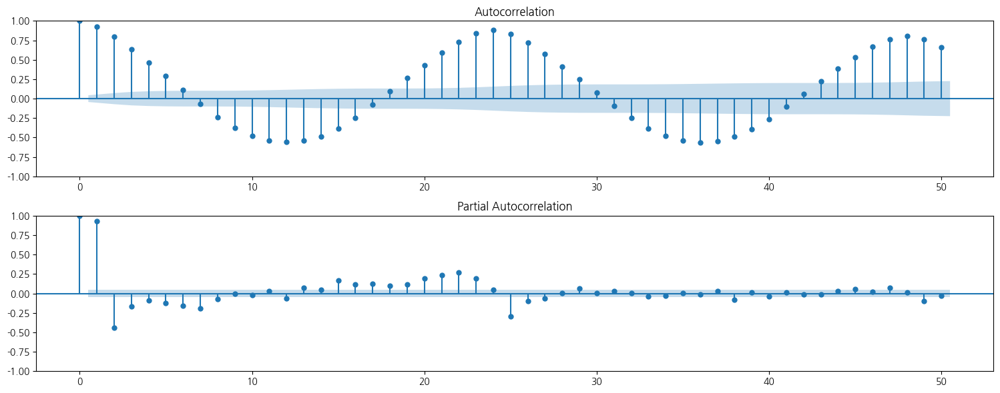

In [26]:
## 건물4
df = train[train.건물번호==4]
fig, (ax1, ax2) = plt.subplots(nrows=2, figsize=(15, 6))
plot_acf(df['전력사용량'], lags=50, ax=ax1)
plot_pacf(df['전력사용량'], lags=50, ax=ax2)
plt.tight_layout()
plt.show()

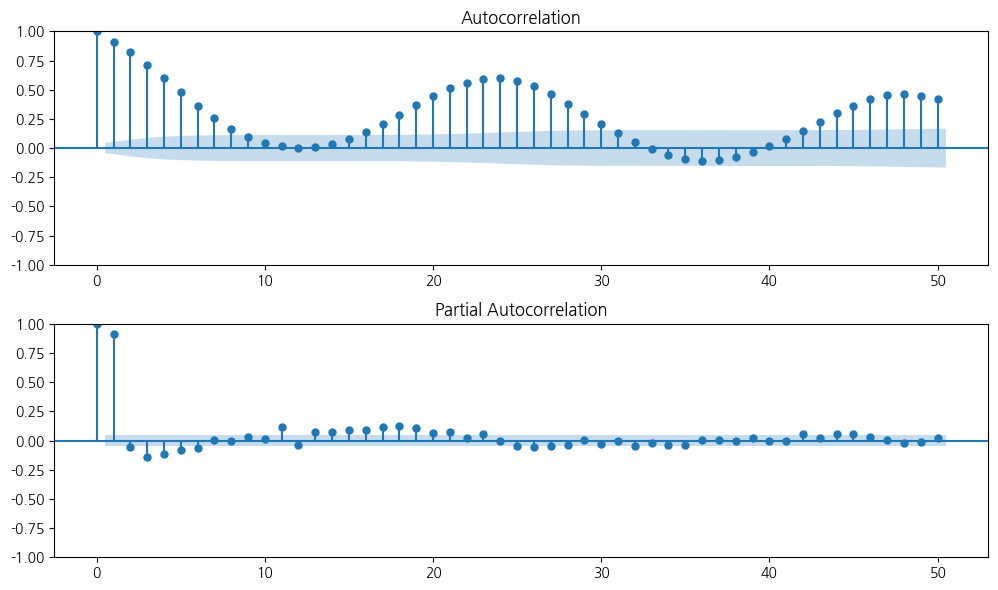

In [27]:
## 건물9
df = train[train.건물번호==9]
fig, (ax1, ax2) = plt.subplots(nrows=2, figsize=(10, 6))
plot_acf(df['전력사용량'], lags=50, ax=ax1)
plot_pacf(df['전력사용량'], lags=50, ax=ax2)
plt.tight_layout()
plt.show()

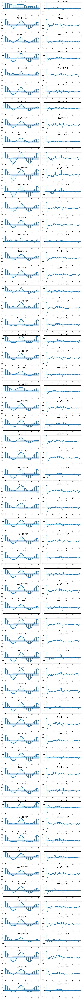

In [28]:
# 전체 건물에 대한 ACF와 PACF 그래프 그리기
fig, axes = plt.subplots(nrows=60, ncols=2, figsize=(10, 120))

for i in range(1, 61):
    # 건물 번호별 데이터 추출
    df = train[train['건물번호'] == i]
    
    # ACF 그래프 그리기
    ax1 = axes[i-1, 0]
    plot_acf(df['전력사용량'], lags=50, ax=ax1)
    ax1.set_title(f'건물번호 {i} - ACF')
    
    # PACF 그래프 그리기
    ax2 = axes[i-1, 1]
    plot_pacf(df['전력사용량'], lags=50, ax=ax2)
    ax2.set_title(f'건물번호 {i} - PACF')

plt.tight_layout()
plt.show()

# ACF를 보면 6이나 5 다음부터 0으로 수렴하는 경향이 많이 관측되고 PACF는 거의 모든 그래프가 1 다음에는 신뢰구간에 들어가기 때문에 p는 6이나 5, q는 1이 적당하다고 판단하였습니다.
# 그러나, 1번 건물이 비정상성으로 판단됨

# 0 지역(평일/주말 관계없이 9~20시 시간대에 전력량 최대, 사용 폭이 큼, 평일과 주말 모두 사용량이 일정함) : peak 점이 느리게 감소
# 1 지역(시간별 사용량 차이가 크지 않고 저녁에 조금 더 사용함, 일주일 단위로 봤을 때 요일별 큰 차이 없음) : 1, 5번 건물처럼 상관관계가 0 밑으로 많이 내려가지 않으면서 1일의 주기를 가짐
# 2 지역(새벽 0~6시를 제외한 모든 시간에 대부분 사용, 18시 이후 저녁~밤 시간대에 가장 많이 사용함, 평일보다 주말에 더 많이 사용함) : W 형태의 상관함수 그래프를 가짐
# 3 지역(0과 비슷하지만 사용 폭이 작음, 평일에 사용량이 많고 주말에는 적음) : peak 점이 빠르게 감소 (61번 건물)

<Figure size 1000x600 with 0 Axes>

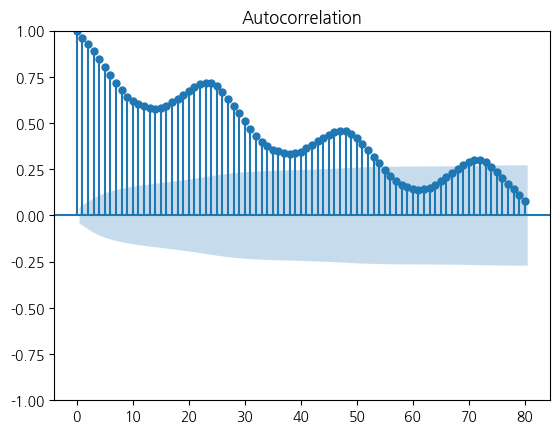

In [29]:
a1 = train[train.건물번호==1]
a1['전력사용량_차분'] = a1['전력사용량'].diff(1)
fig = plt.figure(figsize=(10,6))
plot_acf(a1['전력사용량'], lags=80)
plt.show()

<Figure size 1000x600 with 0 Axes>

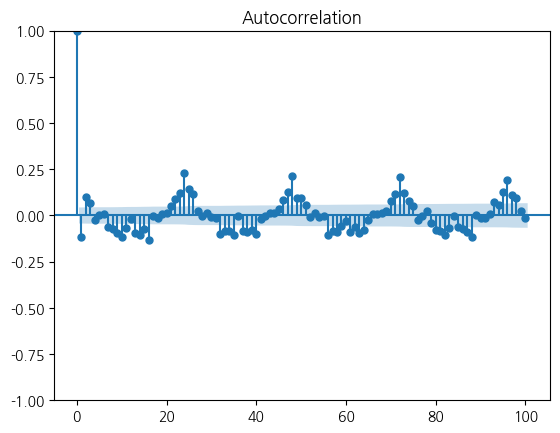

In [30]:
fig = plt.figure(figsize=(10,6))
aa1 = a1['전력사용량_차분'].dropna()
plot_acf(aa1, lags=100)
plt.show()

In [31]:
a1['전력사용량']

0       8179.056
1       8135.640
2       8107.128
3       8048.808
4       8043.624
          ...   
2035    8714.952
2036    8740.224
2037    8730.504
2038    8725.968
2039    8705.232
Name: 전력사용량, Length: 2040, dtype: float64

In [32]:
a1['전력사용량_차분']

0          NaN
1      -43.416
2      -28.512
3      -58.320
4       -5.184
         ...  
2035   -32.400
2036    25.272
2037    -9.720
2038    -4.536
2039   -20.736
Name: 전력사용량_차분, Length: 2040, dtype: float64

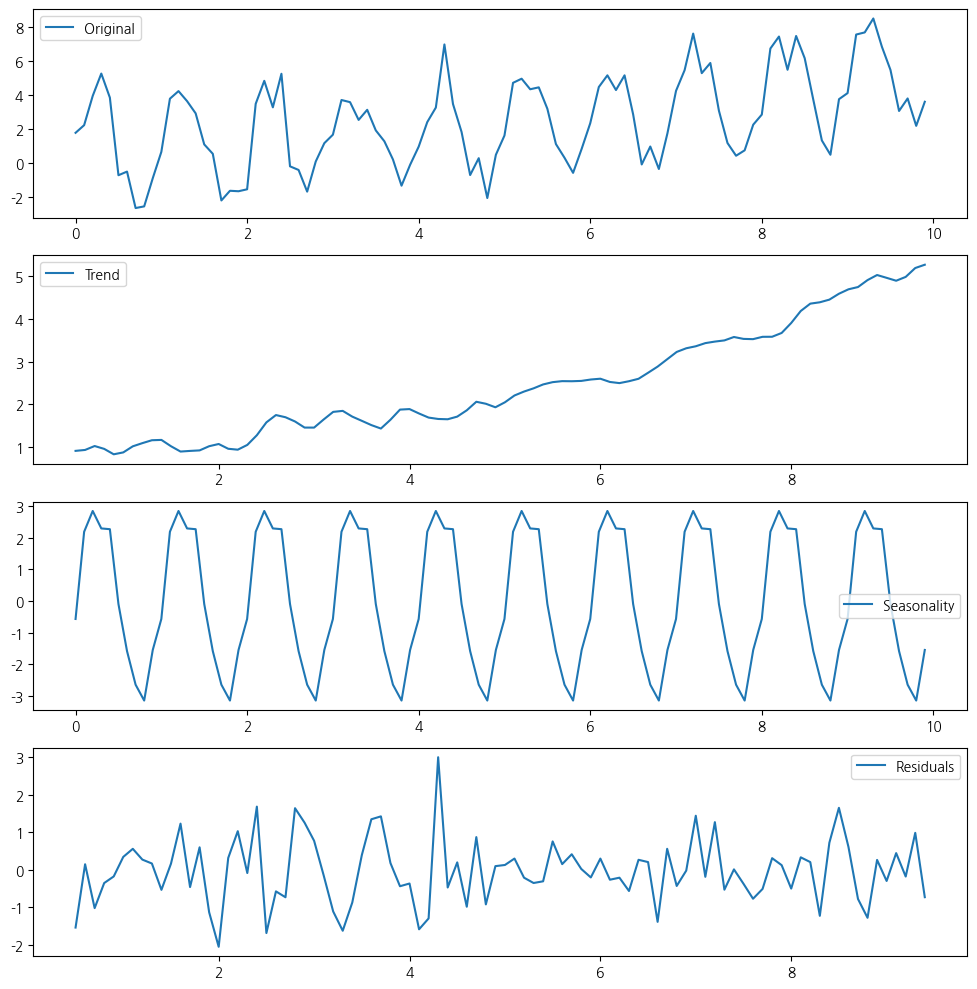

In [33]:
import numpy as np
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose

# 임의의 시계열 데이터 생성
np.random.seed(0)
t = np.arange(0, 10, 0.1)
seasonal_component = 3 * np.sin(2 * np.pi * t)
trend_component = 0.5 * t  # 선형적으로 증가하는 추세
noise = np.random.randn(len(t))
y = seasonal_component + trend_component + noise

# 시계열 분해
result = seasonal_decompose(y, model='additive', period=10)  # 주기를 10으로 설정

# 분해된 시계열 데이터 가져오기
trend = result.trend
seasonal = result.seasonal
residual = result.resid

# 시계열 데이터 및 분해 결과 시각화
plt.figure(figsize=(10, 10))

# 원본 시계열 데이터
plt.subplot(411)
plt.plot(t, y, label='Original')
plt.legend(loc='best')

# 추세 (Trend) 성분
plt.subplot(412)
plt.plot(t, trend, label='Trend')
plt.legend(loc='best')

# 계절성 (Seasonal) 성분
plt.subplot(413)
plt.plot(t, seasonal, label='Seasonality')
plt.legend(loc='best')

# 잔차 (Residual) 성분
plt.subplot(414)
plt.plot(t, residual, label='Residuals')
plt.legend(loc='best')

plt.tight_layout()
plt.show()

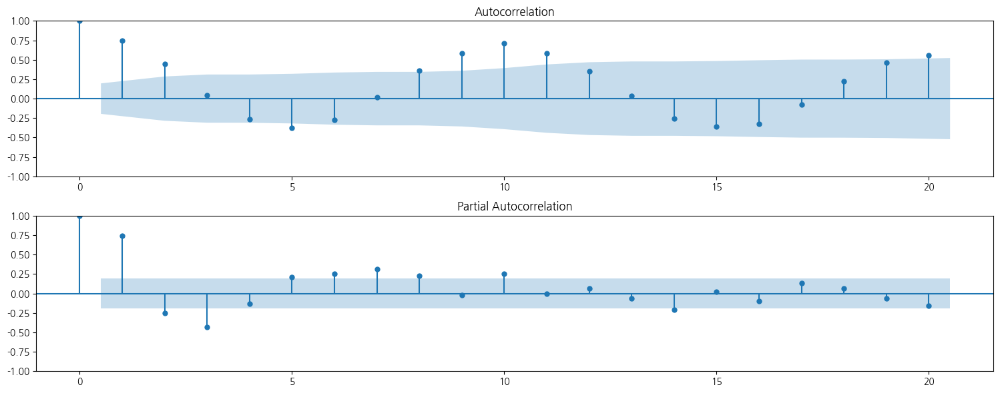

In [34]:
fig, (ax1, ax2) = plt.subplots(nrows=2, figsize=(15, 6))
plot_acf(y, lags=20, ax=ax1)
plot_pacf(y, lags=20, ax=ax2)
plt.tight_layout()
plt.show()

# AR(2), MA(1)

In [35]:
from statsmodels.tsa.arima.model import ARIMA

# ARIMA 모델 생성 및 훈련
model = ARIMA(y, order=(5, 2, 2))  # (p, d, q) 값으로 ARIMA 모델의 차수를 설정합니다.
model_fit = model.fit()

# 모델 예측
forecast = model_fit.predict(start=len(y), end=len(y) + 50)  # 10개의 미래 예측을 수행합니다.

# 예측 결과 출력
print(forecast)

[ 5.80777753  7.47657175  8.52846935  9.08692863  7.96265447  6.35205686
  4.84556276  3.85928607  3.87560374  5.03865289  6.71980611  8.37965084
  9.43531902  9.48116135  8.56060092  7.12020717  5.7317385   4.97383033
  5.17122191  6.25396977  7.81736755  9.28914895 10.1326946  10.0705546
  9.18448416  7.86950725  6.67811292  6.10533293  6.39408658  7.44899009
  8.88126856 10.16407721 10.83969991 10.69577785  9.84128082  8.65756536
  7.64519634  7.2274692   7.58837215  8.60681823  9.91000624 11.02310423
 11.55520143 11.34863399 10.53486063  9.47734457  8.6258927   8.34078611
  8.75539784  9.72955353 10.90971156]


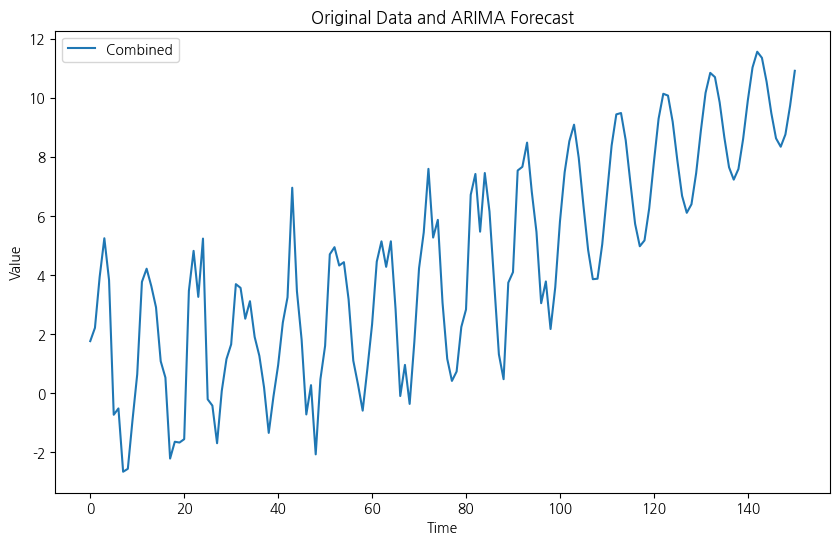

In [36]:
# 합쳐진 데이터 생성
combined_data = np.concatenate([y, forecast])

# 시계열 데이터 및 예측 결과 시각화
plt.figure(figsize=(10, 6))

# 원본 시계열 데이터


# 전체 데이터
plt.plot(np.arange(len(combined_data)), combined_data, label='Combined')

plt.legend(loc='best')
plt.xlabel('Time')
plt.ylabel('Value')
plt.title('Original Data and ARIMA Forecast')
plt.show()

# 군집

## 건물 군집

In [37]:
# 건물을 기준으로 하는 data frame 생성
by_weekday = train.groupby(['건물번호','weekday'])['전력사용량'].median().reset_index().pivot('건물번호','weekday','전력사용량').reset_index()
by_hour = train.groupby(['건물번호','hour'])['전력사용량'].median().reset_index().pivot('건물번호','hour','전력사용량').reset_index().drop('건물번호', axis = 1)
df = pd.concat([by_weekday, by_hour], axis= 1)
columns = ['건물번호'] + ['day'+str(i) for i in range(7)] + ['hour'+str(i) for i in range(24)]
df.columns = columns

In [38]:
# '전력사용량'이 아닌 '요일과 시간대에 따른 전력 사용량의 경향성'에 따라서만 군집화 할 것이므로, 특수한 scaling이 필요함
# standard scaling
for i in range(len(df)):
    # 요일 별 전력 중앙값에 대해 scaling
    df.iloc[i,1:8] = (df.iloc[i,1:8] - df.iloc[i,1:8].mean())/df.iloc[i,1:8].std()
    # 시간대별 전력 중앙값에 대해 scaling
    df.iloc[i,8:] = (df.iloc[i,8:] - df.iloc[i,8:].mean())/df.iloc[i,8:].std()

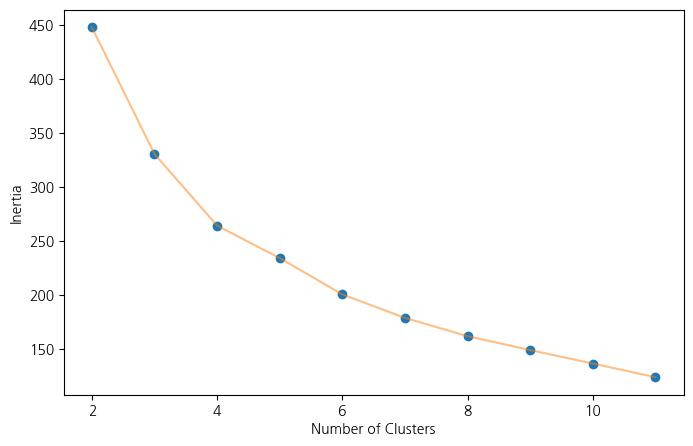

In [39]:
# elbow method를 통해 군집의 개수 결정
def change_n_clusters(n_clusters, data):
    sum_of_squared_distance = []
    for n_cluster in n_clusters:
        kmeans = KMeans(n_clusters=n_cluster)
        kmeans.fit(data)
        sum_of_squared_distance.append(kmeans.inertia_)
        
    plt.figure(1 , figsize = (8, 5))
    plt.plot(n_clusters , sum_of_squared_distance , 'o')
    plt.plot(n_clusters , sum_of_squared_distance , '-' , alpha = 0.5)
    plt.xlabel('Number of Clusters')
    plt.ylabel('Inertia')

change_n_clusters([2,3,4,5,6,7,8,9,10,11], df.iloc[:,1:])

In [40]:
kmeans = KMeans(n_clusters=4, random_state = 2)
km_cluster = kmeans.fit_predict(df.iloc[:,1:])

In [41]:
df_clust = df.copy()
df_clust['건물유형'] = km_cluster

In [42]:
train = train.merge(df_clust[['건물번호','건물유형']], on = '건물번호', how = 'left')
test = test.merge(df_clust[['건물번호','건물유형']], on = '건물번호', how = 'left')

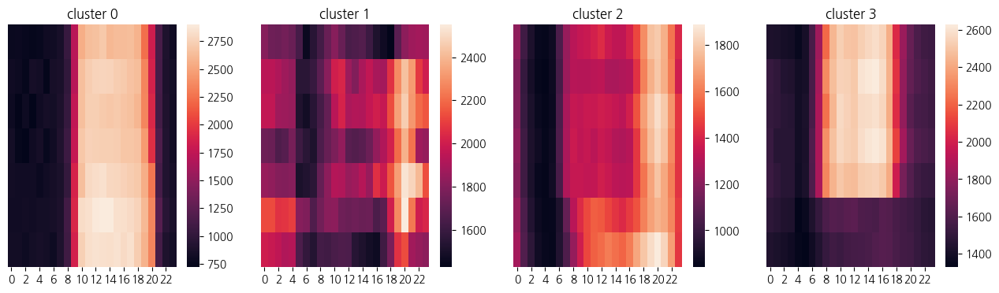

In [43]:
fig = plt.figure(figsize = (20, 4))
for c in range(4):
    temp = train[train.건물유형 == c]
    temp = temp.groupby(['weekday', 'hour'])['전력사용량'].median().reset_index().pivot('weekday', 'hour', '전력사용량')
    plt.subplot(1, 5, c+1)
    sns.heatmap(temp)
    plt.title(f'cluster {c}')
    plt.xlabel('')
    plt.ylabel('')
    plt.yticks([])

## 지역

In [44]:
weather_df = train.groupby(['건물번호']).agg(평균풍속=('풍속','mean'), 평균기온=('기온','mean'), 평균습도=('습도','mean'), 평균일조=('일조','mean'))

In [45]:
# 스케일링
scaler = MinMaxScaler()
weather_df_scale = scaler.fit_transform(weather_df)
weather_df_scale = pd.DataFrame(weather_df_scale, index = weather_df.index, columns=weather_df.columns)
# 변환된 데이터셋은 수치화 되어있으므로 데이터프레임화 시켜준다.

In [46]:
pca = PCA(n_components = 2)           # 2차원으로 시각화를 진행할 것이므로 2개로 설정한다.
pca.fit(weather_df_scale)             
weather_df_scale_pca = pca.transform(weather_df_scale)
weather_df_scale_pca = pd.DataFrame(weather_df_scale_pca, columns = ['PC1','PC2']) #PCA진행 한 두 개의 값을 column으로 데이터프레임화 시킨다.

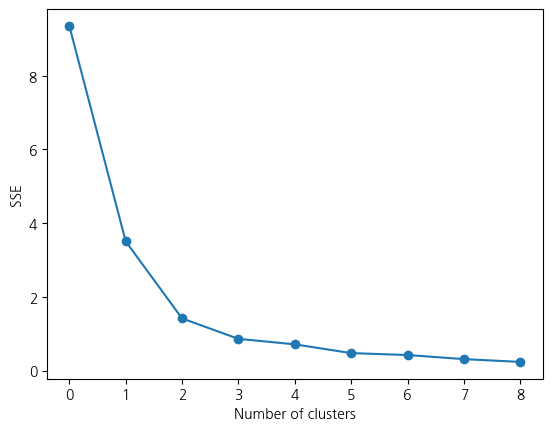

In [47]:
# 엘보우 기법
# 그래프볼 때 k 3개가 최적의 k값으로 보임

sse=[]
for k in range(1,10):
    kmeans = KMeans(n_clusters=k, random_state=42, n_init='auto')
    kmeans.fit(weather_df_scale_pca)
    sse.append(kmeans.inertia_)

plt.rc('font', family='NanumGothic')
plt.plot(sse, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('SSE')
plt.show()

In [48]:
# 그룹 수, random_state 설정
k=3

model = KMeans(n_clusters = k, random_state = 42)

# 정규화된 데이터에 학습
model.fit(weather_df_scale_pca)

# 클러스터링 결과 각 데이터가 몇 번째 그룹에 속하는지 저장
weather_df_scale_pca['cluster'] = model.labels_

In [49]:
clusters = weather_df_scale_pca.groupby('cluster')
print(clusters.mean())
print(clusters.size())

              PC1       PC2
cluster                    
0       -0.365763 -0.144398
1        0.528818 -0.089677
2       -0.037800  0.157259
cluster
0    19
1    15
2    26
dtype: int64


In [50]:
weather_df['cluster'] = model.fit_predict(weather_df_scale_pca)

areas = {0: list(weather_df[weather_df['cluster'] == 0].index),
         1: list(weather_df[weather_df['cluster'] == 1].index),
         2: list(weather_df[weather_df['cluster'] == 2].index)}

train['area'] = train['건물번호'].apply(lambda x: next((key for key, value in areas.items() if x in value), None))
test['area'] = test['건물번호'].apply(lambda x: next((key for key, value in areas.items() if x in value), None))

# 모델링

## ARIMA

In [124]:
#2d의 데이터프레임을 건물별 정보를 반영한 3d 데이터로 변환
def df2d_to_array3d(df_2d):
    feature_size=df_2d.iloc[:,2:].shape[1]
    time_size=len(df_2d['시간'].value_counts())
    sample_size=len(df_2d.건물번호.value_counts())
    return df_2d.iloc[:,2:].values.reshape([sample_size, time_size, feature_size])
    

In [125]:
train_x_array=df2d_to_array3d(train[['건물번호', '시간','전력사용량']])
test_x_array=df2d_to_array3d(test)

In [126]:
len(train_x_array[0,:,0])

2040

In [127]:
valid_pred_array=np.zeros([60, 168])
for i in tqdm(range(60)):
  x_series=train_x_array[i, :, 0]
  model=ARIMA(x_series, order=(5, 1, 1))
  fit=model.fit()
  preds=fit.predict(2040 - 167, 2040, typ='levels')
  valid_pred_array[i, :]=preds
    

  0%|          | 0/60 [00:00<?, ?it/s]

In [128]:
valid_pred_array.shape

(60, 168)

In [131]:
test['전력사용량'] = valid_pred_array.reshape(-1, 1)

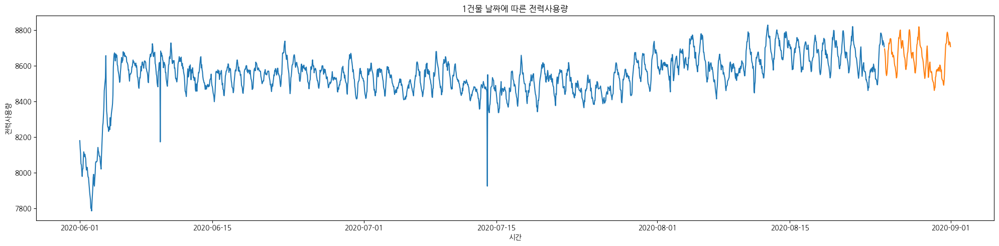

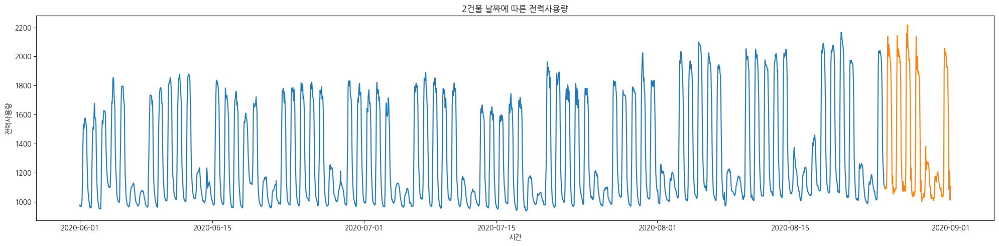

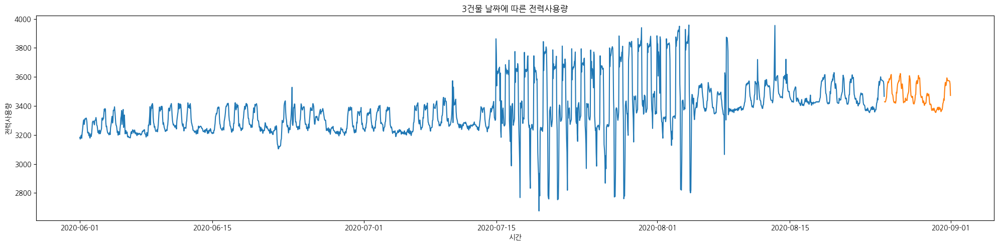

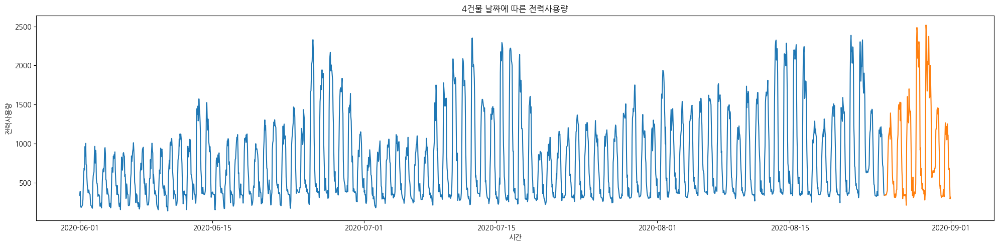

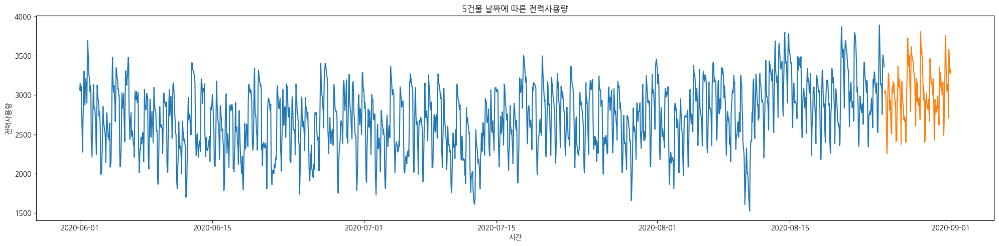

...

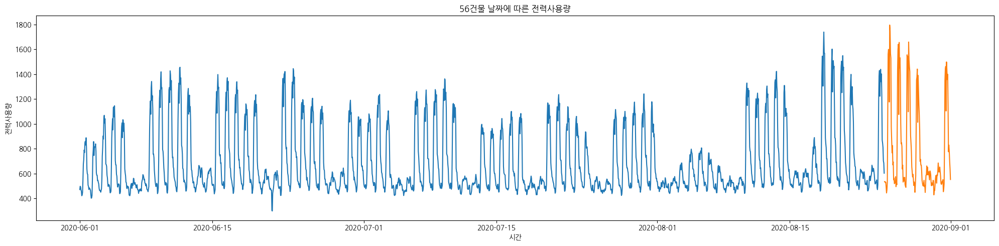

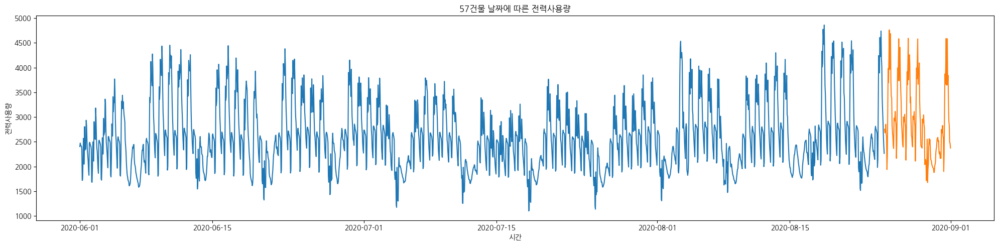

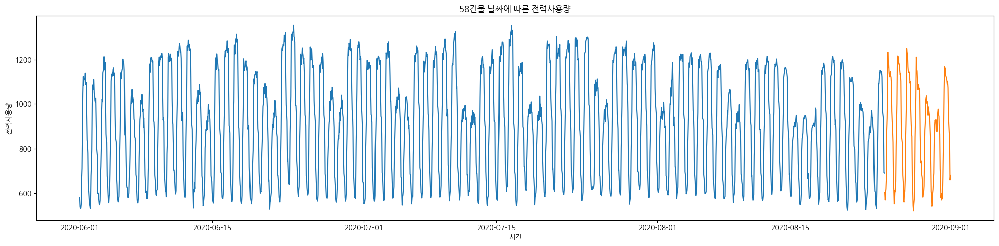

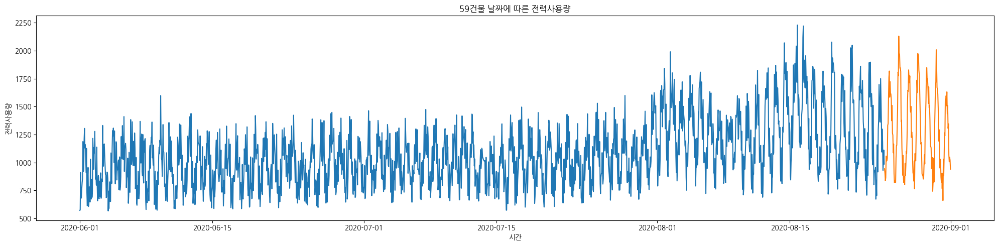

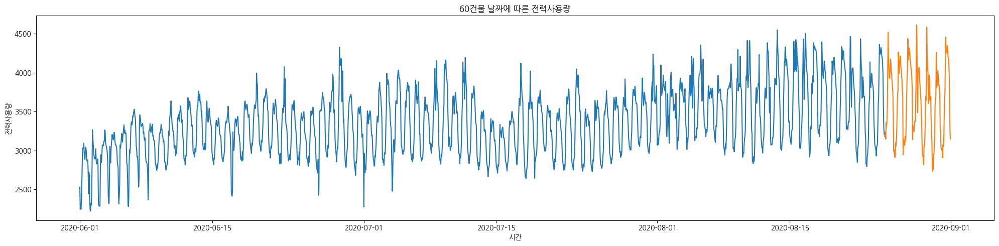

In [132]:
for i in range(1, 61):
    fig = plt.figure(figsize = (20, 5))
    ax = fig.add_subplot()
    ax = sns.lineplot(x=train[(train['건물번호'] == i)]['시간'],
                        y=train[(train['건물번호'] == i)]['전력사용량'])
    ax = sns.lineplot(x=test[(test['건물번호'] == i)]['시간'],
                        y=test[(test['건물번호'] == i)]['전력사용량'])
    # ax.set_ylim(2000, 8000)
    # ax.set_xlim(0, 24)
    # ax.set_title(f'6월 {i}일 전력사용량')
    
    # plt.grid(False)
    plt.title(f'{i}건물 날짜에 따른 전력사용량')
    # plt.xlabel('날짜')
    # plt.ylabel('전력사용량(kWh)', rotation = True, labelpad = 20)
    fig.tight_layout()
    plt.show()

In [133]:
sub['answer'] = test['전력사용량']

sub.to_csv('submit_1102_ARIMA.csv', index = False)

In [134]:
test.drop('전력사용량',axis=1, inplace = True)

## XGboost

In [135]:
def SMAPE(true, pred):
    return np.mean((np.abs(true-pred))/(np.abs(true) + np.abs(pred))) * 100

In [136]:
# - 건물 유형별로 성능이 다르지 않을까? 또는 사용 모델이 다르지 않을까? (기본 : 건물별로)
# xgb, lgbm, cat, et

### 전체 데이터에 대해서

In [137]:
# # 건물별 하이퍼 파라미터 탐색
# # learning_rate, max_depth 튜닝
# from sklearn.model_selection import GridSearchCV
# param = pd.DataFrame(np.zeros(60))

# lr=[]
# max_de=[]
# subsam=[]

# for i in tqdm(range(1,61)):
#     ## 피처 골라내서 데이터프레임 만들기
#     train_y = pd.DataFrame(train[train['건물번호']==i]['전력사용량'])
#     train_x = train[train['건물번호']==i].drop(columns=['전력사용량', 'date', '시간', '건물번호'])
#     train_x = train_x
#     X_train, X_test, y_train, y_test = train_test_split(train_x, train_y, test_size=0.3, random_state=156)
    
#     ## 모델 형성 및 학습
#     model=XGBRegressor(n_estimators=100)
#     xgb_param = { 
#             'learning_rate': [0.01,0.05,0.1,0.3],
#             'max_depth': [3, 7, 10, 15],
#             'subsample' : [0.5, 0.8]
#     }
#     grid_xgb = GridSearchCV(model, param_grid=xgb_param, cv=5)
#     grid_xgb.fit(X_train, y_train, eval_set=[ (X_test, y_test)], early_stopping_rounds=30, verbose=False)

#     ## 최적 하이퍼 파라미터 저장    
#     lr.append(grid_xgb.best_params_['learning_rate'])
#     max_de.append(grid_xgb.best_params_['max_depth'])
#     subsam.append(grid_xgb.best_params_['subsample'])

In [138]:
# xgb_params = pd.DataFrame({'learning_rate': lr, 'max_depth': max_de, 'subsample': subsam})
# xgb_params.to_csv('xgb_params.csv', index=False)

In [52]:
xgb_params = pd.read_csv('./xgb_params.csv')
xgb_params.head()

,learning_rate,max_depth,subsample
0,0.10,7,0.8
1,0.10,7,0.8
2,0.10,10,0.8
3,0.05,7,0.5
4,0.10,7,0.8


  0%|          | 0/60 [00:00<?, ?it/s]

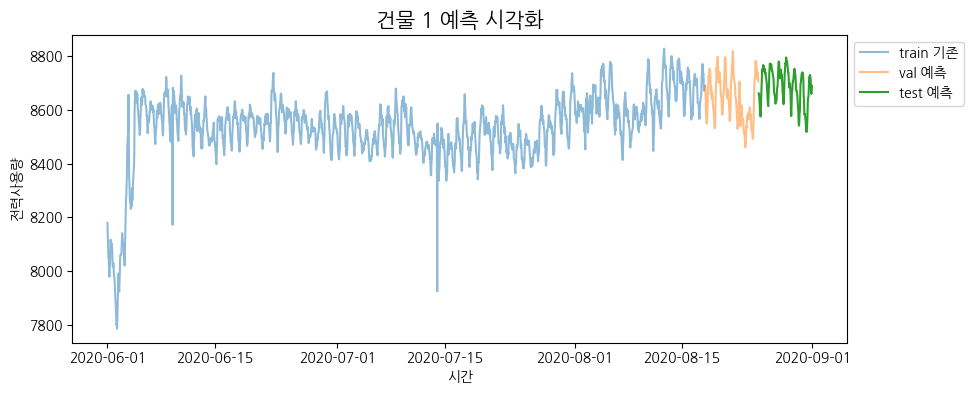

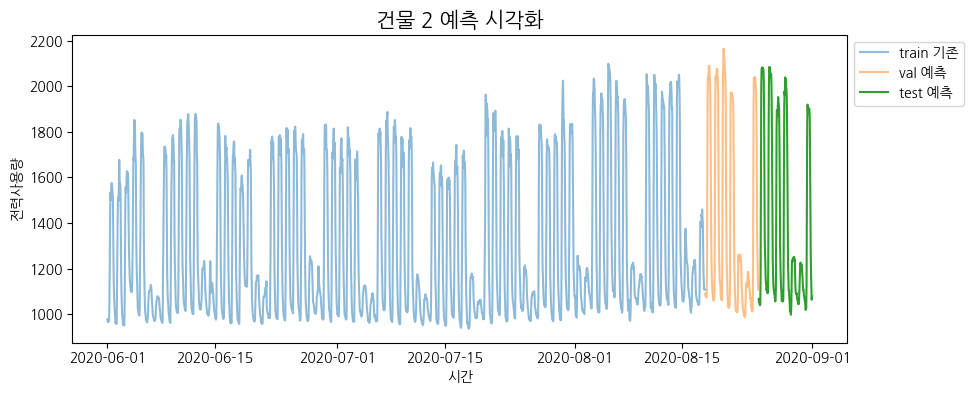

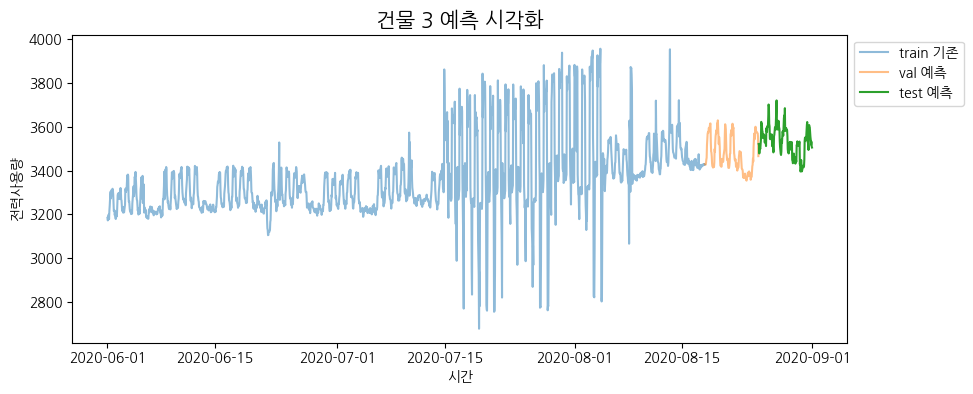

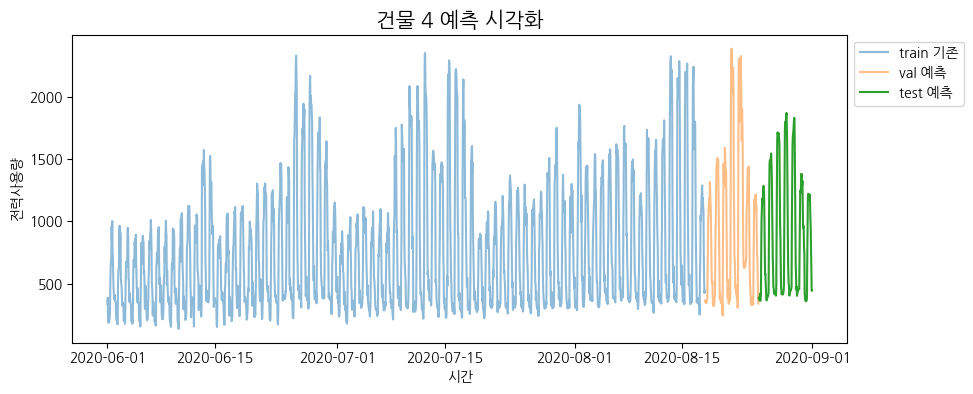

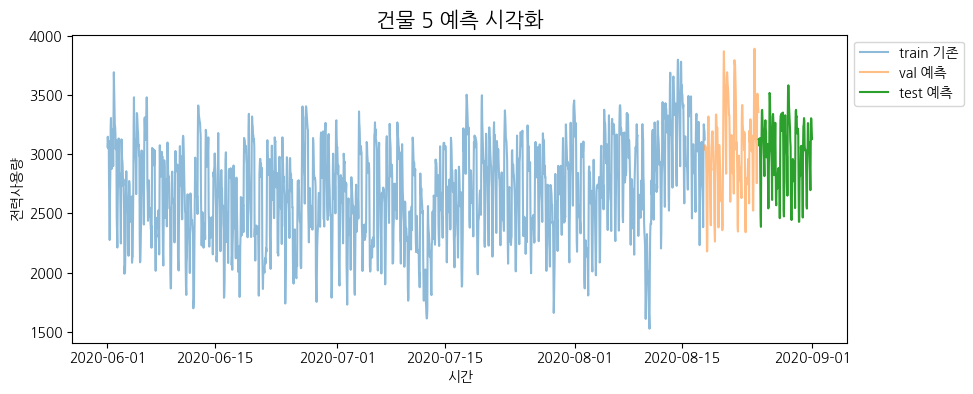

...

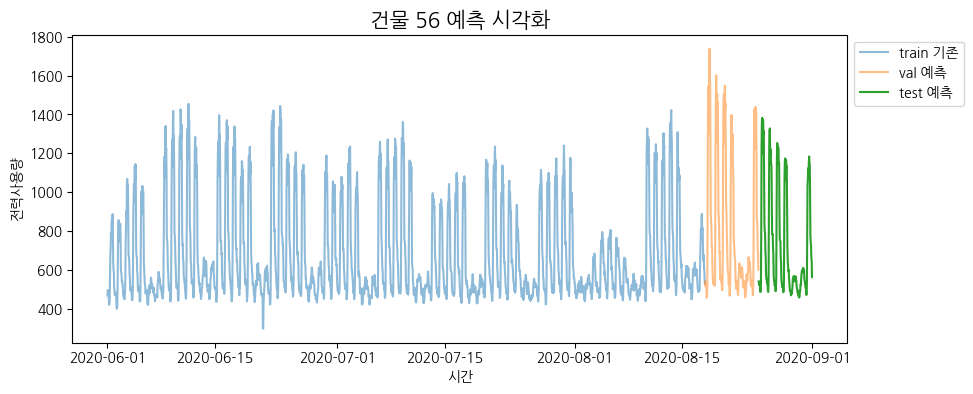

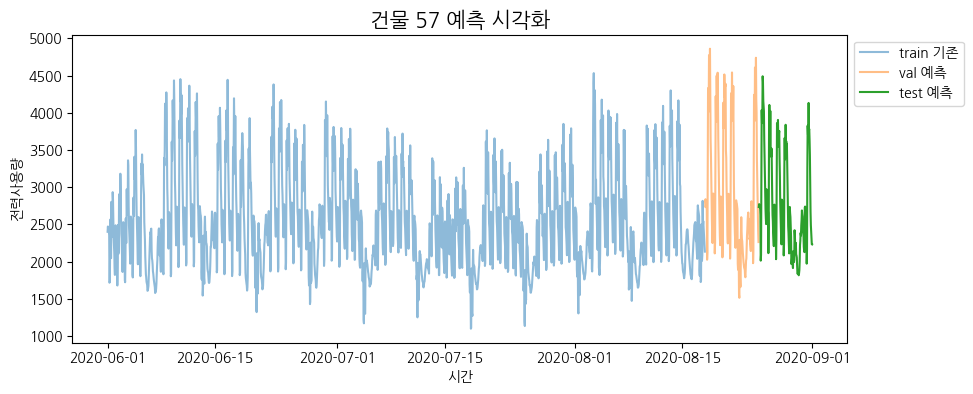

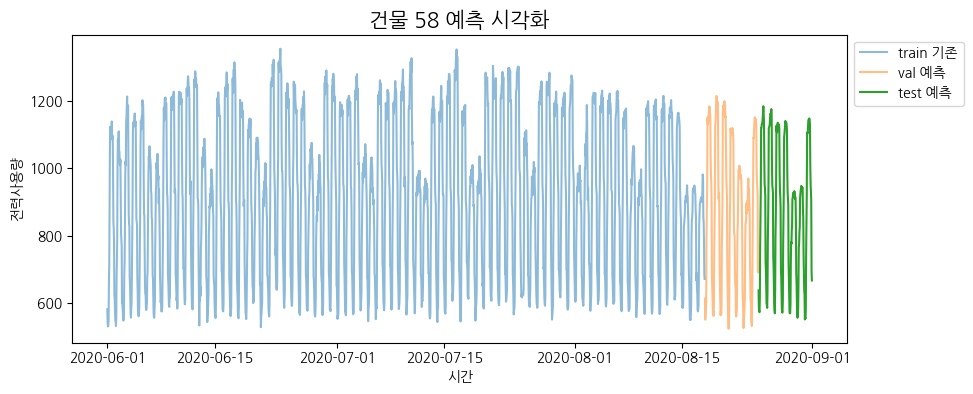

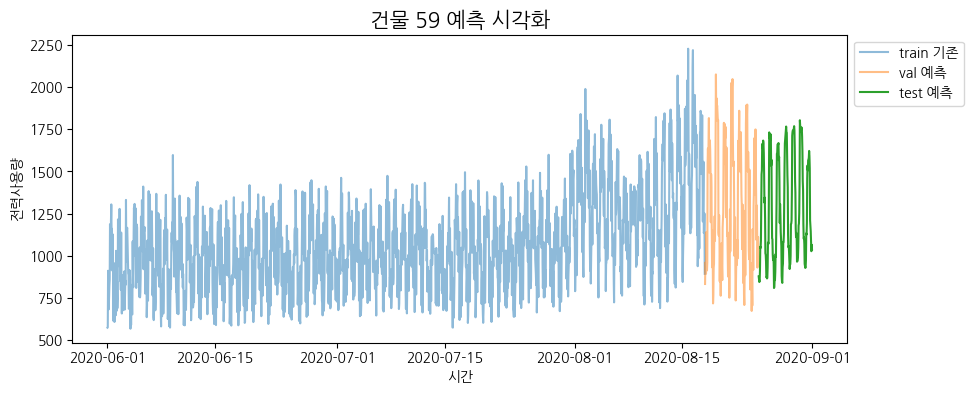

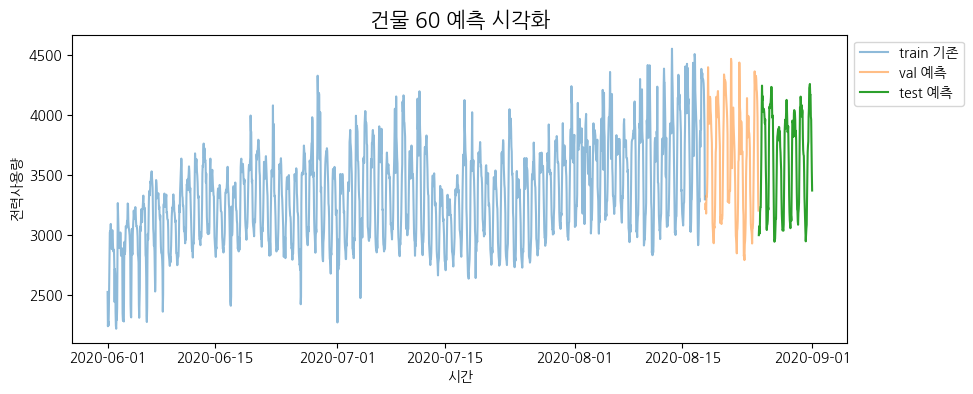

In [142]:
pred_test=[]
for i in tqdm(range(1,61)):
    train_y = pd.DataFrame(train[train['건물번호']==i]['전력사용량'])
    train_x = train[train['건물번호']==i].drop(columns=['전력사용량', 'date', '시간','건물번호'])
    test_x = test[test['건물번호']==i].drop(columns=['date', '건물번호'])
    train_x = train_x
    y_train, y_valid, x_train, x_valid = temporal_train_test_split(y = train_y, X = train_x, test_size = 168) # 24시간*7일 = 168

    parm = {
        'learning_rate' : xgb_params.iloc[i-1,0],
        'max_depth' : xgb_params.iloc[i-1,1],
        'subsample' : xgb_params.iloc[i-1,2]
    }
    xgb = XGBRegressor(random_state=42, **parm)

    xgb = xgb.fit(x_train, y_train)
    g1 = xgb.predict(x_train)
    g2 = xgb.predict(x_valid)
    xgb = xgb.fit(train_x, train_y)
    g3 = xgb.predict(test_x.drop('시간',axis=1))
    pred_test.append(g3)

    train_y1 = train_y.reset_index()
    fig = plt.figure(figsize = (10 ,4))
    plt.title(f'건물 {i} 예측 시각화', size = 15)
    sns.lineplot(x = train['시간'], y = y_train['전력사용량'],alpha=0.5, label = 'train 기존')
    sns.lineplot(x = train['시간'], y = y_valid['전력사용량'], alpha=0.5, label = 'val 예측')
    sns.lineplot(x = test_x['시간'], y = g3, label = 'test 예측')
    plt.xticks()
    plt.legend(bbox_to_anchor=(1.0, 1.0), loc='upper left')

plt.show()


# 그래프르 봤을 때, 추세를 못따라가는 느낌? 
# 추세선을 다항회귀로 처리해서 합치면 어떨까?

In [143]:
arr_2d = np.array(pred_test)

# 2차원 배열을 1차원 배열로 변환
pred_final_1D = arr_2d.flatten()

# 결과 출력
print(pred_final_1D)

[8661.384  8659.692  8644.296  ... 3725.7273 3528.3264 3371.2952]


In [144]:
sub['answer'] = pred_final_1D
sub.to_csv('submit_1031.csv', index=False)

### 건물별 최고 성능 모델 선택

In [145]:
# 각 건물의 validation data의 SMAPE 비교하고 최소 SMAPE의 모델 선택

def evalSMAPE(x, y):
    y_train, y_valid, x_train, x_valid = temporal_train_test_split(y = y, X = x, test_size = 168) # 24시간*7일 = 168
    
    xgb_model = XGBRegressor(random_state=42).fit(x_train, y_train);
    lgbm_model = LGBMRegressor(random_state=42).fit(x_train, y_train);
    cat_model = CatBoostRegressor(random_state=42, verbose=False).fit(x_train, y_train);
    et_model = ExtraTreeRegressor(random_state=42).fit(x_train, y_train);
    
    
    pred_xgb=xgb_model.predict(x_valid);
    pred_lgbm=lgbm_model.predict(x_valid);
    pred_cat=cat_model.predict(x_valid);
    pred_et=et_model.predict(x_valid);

    flag = 0
    
    if min(SMAPE(y_valid, pred_xgb), SMAPE(y_valid, pred_lgbm), SMAPE(y_valid, pred_cat), SMAPE(y_valid, pred_et)) == SMAPE(y_valid, pred_xgb):
        model = xgb_model
        flag = 1
    elif min(SMAPE(y_valid, pred_xgb), SMAPE(y_valid, pred_lgbm), SMAPE(y_valid, pred_cat), SMAPE(y_valid, pred_et)) == SMAPE(y_valid, pred_lgbm):
        model = lgbm_model
        flag = 2
    elif min(SMAPE(y_valid, pred_xgb), SMAPE(y_valid, pred_lgbm), SMAPE(y_valid, pred_cat), SMAPE(y_valid, pred_et)) == SMAPE(y_valid, pred_cat):
        model = cat_model
        flag = 3
    elif min(SMAPE(y_valid, pred_xgb), SMAPE(y_valid, pred_lgbm), SMAPE(y_valid, pred_cat), SMAPE(y_valid, pred_et)) == SMAPE(y_valid, pred_et):
        model = et_model
        flag = 4
        
    return model, flag
    

In [146]:
models = []
flags = []

for i in tqdm(range(1, 61)):
    a = train[train['건물번호']==i]

    x = a.iloc[:, 3:]
    y = a['전력사용량']
    x.drop('date',axis=1, inplace=True)

    model, flag = evalSMAPE(x, y)
    models.append(model)
    flags.append(flag)

  0%|          | 0/60 [00:00<?, ?it/s]

In [147]:
# # 건물별 하이퍼 파라미터 탐색
# # learning_rate, max_depth 튜닝
# param = pd.DataFrame(np.zeros(60))

# bp_params = []

# for i in tqdm(range(1,61)):
#     ## 피처 골라내서 데이터프레임 만들기
#     train_y = pd.DataFrame(train[train['건물번호']==i]['전력사용량'])
#     train_x = train[train['건물번호']==i].drop(columns=['전력사용량', 'date', '시간', '건물번호'])
#     train_x = train_x
#     # y_train, y_valid, x_train, x_valid = temporal_train_test_split(y = train_y, X = train_x, test_size = 168) # 24시간*7일 = 168 -> 7.5
    
#     x_train, x_valid, y_train, y_valid = train_test_split(train_x, train_y, test_size=0.3, random_state=42)
#     ## 모델 형성 및 학습
#     flag = flags[i-1]
#     model=models[i-1]
#     xgb_param = { 
#             'n_estimators' : [100],
#             'learning_rate': [0.01,0.05,0.1,0.3],
#             'max_depth': [3, 7, 10, 15],
#             'subsample' : [0.5, 0.8]
#     }

#     lgbm_param = {
#         'n_estimators' : [100],
#         'learning_rate': [0.01,0.05,0.1,0.3],
#         'max_depth': [3, 7, 10, 15],
#         'subsample' : [0.5, 0.8]
#     }

#     cat_param = {
#         'n_estimators' : [100],
#         'learning_rate': [0.01,0.05,0.1,0.3],
#         'depth' : [3, 6, 10, 15]
#     }

#     et_param = {
#         'max_depth' : [3, 6, 10, 15],
#         'min_samples_split' : [2, 5, 9]
#     }
    
#     if flag == 1:
#         param_model = xgb_param
#     elif flag == 2:
#         param_model = lgbm_param
#     elif flag == 3:
#         param_model = cat_param
#     elif flag == 4:
#         param_model = et_param

    
#     grid_model = GridSearchCV(model, param_grid=param_model, cv=5)
#     grid_model.fit(x_train, y_train)

#     ## 최적 하이퍼 파라미터 저장    
#     bp = grid_model.best_params_
#     bp_params.append(bp)



In [149]:
# df = pd.DataFrame({"bp": bp_params})
# df['model'] = models
# df['flag'] = flags
# df.to_csv('best_param_df.csv', index=False)

In [150]:
best_param_df = pd.read_csv('best_param_df.csv')

  0%|          | 0/60 [00:00<?, ?it/s]

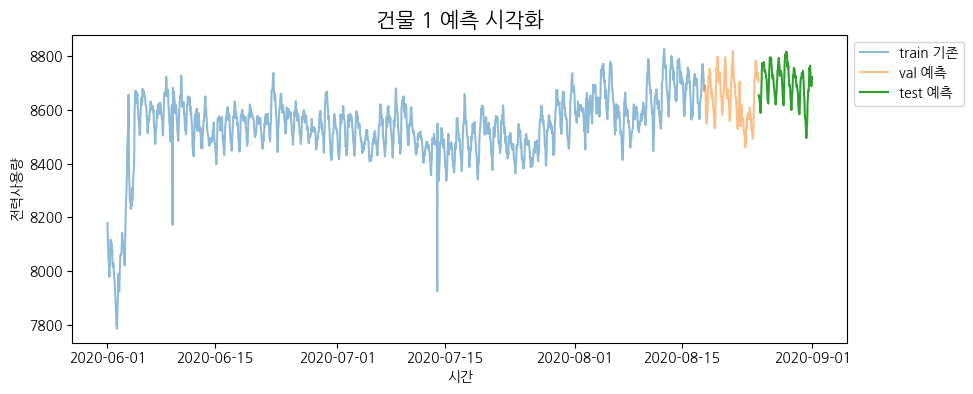

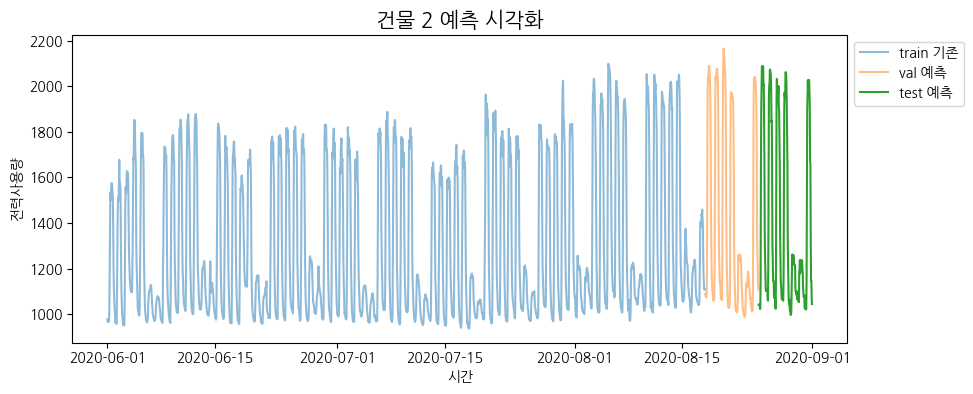

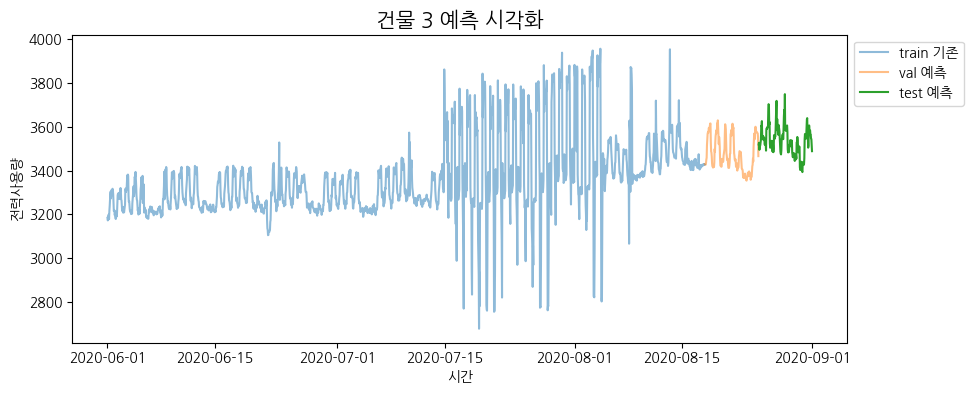

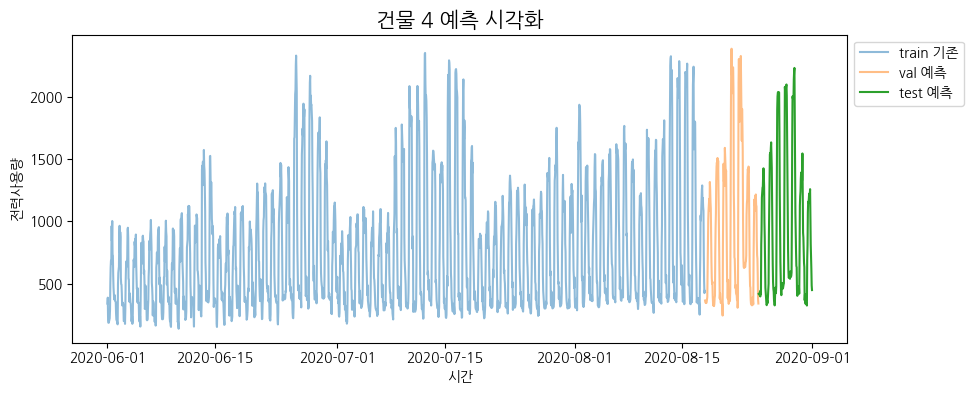

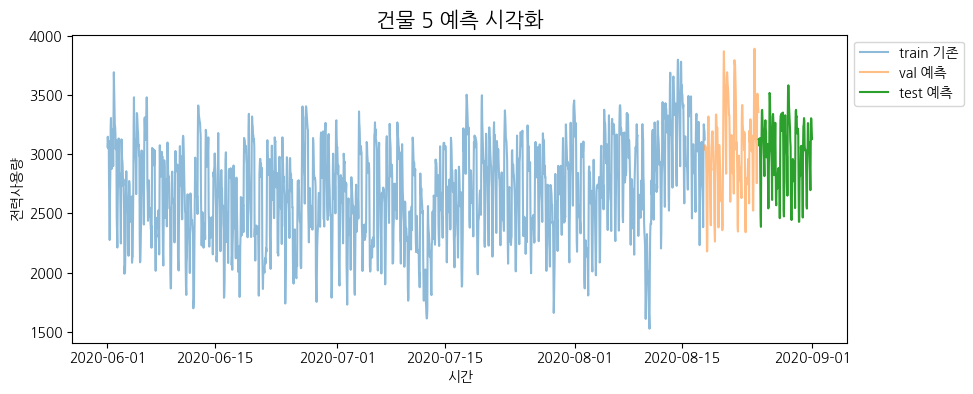

...

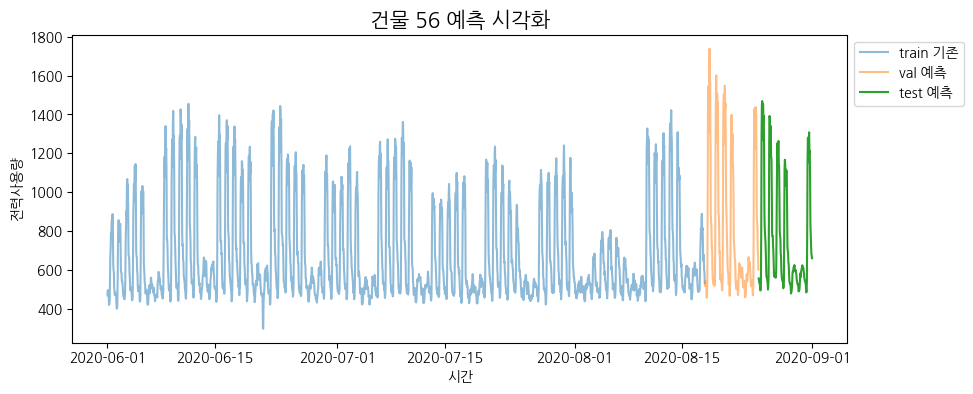

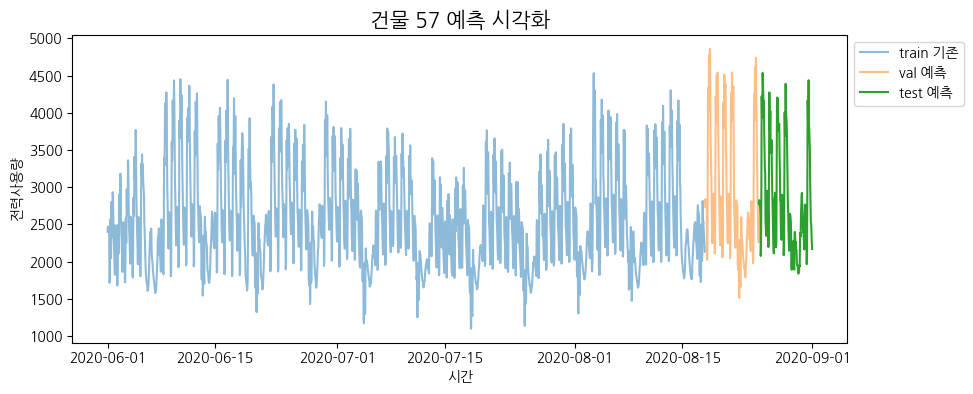

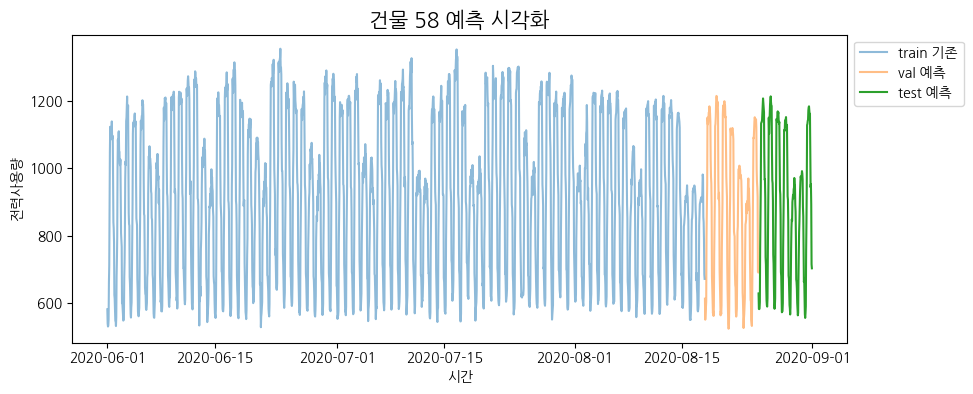

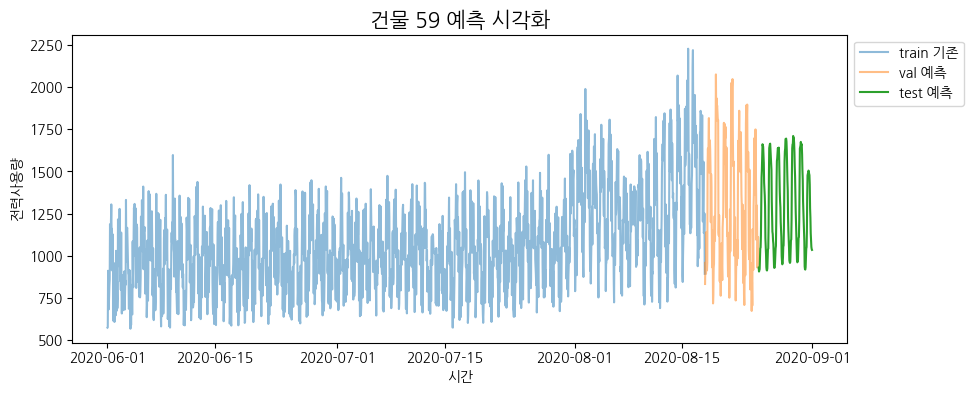

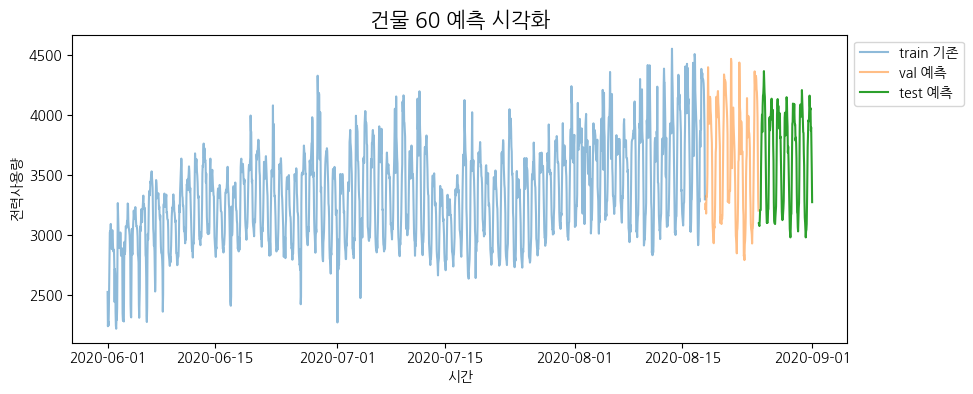

In [151]:
import ast
# ast.literal_eval() 함수를 사용하여 문자열로 표현된 딕셔너리를 실제 딕셔너리 객체로 변환

# 각 건물에 맞는 모델과 파라미터로 학습
pred_test=[]
for i in tqdm(range(1,61)):
    train_y = pd.DataFrame(train[train['건물번호']==i]['전력사용량'])
    train_x = train[train['건물번호']==i].drop(columns=['전력사용량', 'date', '시간', '건물번호'])
    test_x = test[test['건물번호']==i].drop(columns=['date', '건물번호'])
    train_x = train_x
    y_train, y_valid, x_train, x_valid = temporal_train_test_split(y = train_y, X = train_x, test_size = 168) # 24시간*7일 = 168

    params_str = best_param_df['bp'][i-1]
    params_dict = ast.literal_eval(params_str)
    
    if best_param_df['flag'][i-1] == 1:
        model = XGBRegressor(random_state = 42, **params_dict)
    elif best_param_df['flag'][i-1] == 2:
        model = LGBMRegressor(random_state = 42, **params_dict)
    elif best_param_df['flag'][i-1] == 3:
        model = CatBoostRegressor(random_state = 42, **params_dict, verbose=False)
    elif best_param_df['flag'][i-1] == 4:
        model = ExtraTreeRegressor(random_state = 42, **params_dict)
        
    model = model.fit(x_train, y_train)
    g1 = model.predict(x_train)
    g2 = model.predict(x_valid)
    model = model.fit(train_x, train_y)
    g3 = model.predict(test_x.drop(['시간'],axis=1))
    pred_test.append(g3)

    train_y1 = train_y.reset_index()
    fig = plt.figure(figsize = (10 ,4))
    plt.title(f'건물 {i} 예측 시각화', size = 15)
    sns.lineplot(x = train['시간'], y = y_train['전력사용량'],alpha=0.5, label = 'train 기존')
    sns.lineplot(x = train['시간'], y = y_valid['전력사용량'], alpha=0.5, label = 'val 예측')
    sns.lineplot(x = test_x['시간'], y = g3, label = 'test 예측')
    plt.xticks()
    plt.legend(bbox_to_anchor=(1.0, 1.0), loc='upper left')

plt.show()



In [152]:
arr_2d = np.array(pred_test)

# 2차원 배열을 1차원 배열로 변환
pred_final_1D = arr_2d.flatten()


sub['answer'] = pred_final_1D
sub.to_csv('submit_1101_eachMODEL.csv', index=False)

# 후처리 필요

### 두 결과의 평균 - 최종 제출

In [153]:
df1 = pd.read_csv('submit_1031.csv')
df2 = pd.read_csv('submit_1101_eachMODEL.csv')

In [154]:
pred_final = (df1['answer'] + df2['answer']) / 2

In [155]:
sub['answer'] = pred_final

sub.to_csv('submint_1102_ensemble.csv', index=False)

## 추세, 계절성 예측

### 추세 예측

#### 1번 건물 추세

In [173]:
train_y = pd.DataFrame(train[train['건물번호']==1]['전력사용량'])
train_x = train[train['건물번호']==1].drop(columns=['전력사용량', 'date','건물번호'])
test_x = test[test['건물번호']==1].drop(columns=['date', '건물번호'])
train_x = train_x
y_train, y_valid, x_train, x_valid = temporal_train_test_split(y = train_y, X = train_x, test_size = 168) # 24시간*7일 = 168

parm = {
    'learning_rate' : xgb_params.iloc[1-1,0],
    'max_depth' : xgb_params.iloc[1-1,1],
    'subsample' : xgb_params.iloc[1-1,2]
}
xgb = XGBRegressor(random_state=42, **parm)

xgb = xgb.fit(x_train.drop('시간',axis=1), y_train)
g1 = xgb.predict(x_train.drop('시간',axis=1))
g2 = xgb.predict(x_valid.drop('시간',axis=1))
xgb = xgb.fit(train_x.drop('시간',axis=1), train_y)
g3 = xgb.predict(test_x.drop('시간',axis=1))

In [174]:
dp = DeterministicProcess(
                          index = train_x.index, 
                          constant = True,  
                          order = 2, 
                          drop = True,      
                          )

X = dp.in_sample()
lm = LinearRegression(fit_intercept=False)
lm.fit(X, train_y)

test_const = [1 for i in range(test_x.shape[0])]
test_trend = np.arange(X['trend'].max(), X['trend'].max()+test_x.shape[0])
test_trend_squared = [i**2 for i in test_trend]
X_ = pd.DataFrame([test_const, test_trend, test_trend_squared]).T
X_.columns = ['const', 'trend', 'trend_squared']
X_.index = x_valid.index

trend_train = lm.predict(X)
trend_test = lm.predict(X_)

In [175]:
arr_2d = np.array(trend_train)

# 2차원 배열을 1차원 배열로 변환
trend_train = arr_2d.flatten()

# 결과 출력
len(trend_train)

2040

In [176]:
arr_2d = np.array(trend_test)

# 2차원 배열을 1차원 배열로 변환
trend_test = arr_2d.flatten()

# 결과 출력
len(trend_test)

168

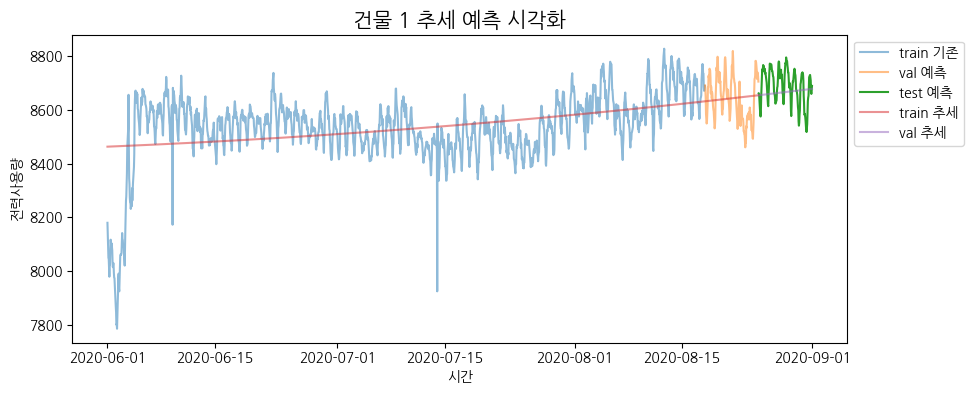

In [177]:
fig = plt.figure(figsize = (10 ,4))
plt.title('건물 1 추세 예측 시각화', size = 15)
sns.lineplot(x = train_x['시간'], y = y_train['전력사용량'],alpha=0.5, label = 'train 기존')
sns.lineplot(x = train_x['시간'], y = y_valid['전력사용량'], alpha=0.5, label = 'val 예측')
sns.lineplot(x = test_x['시간'], y = g3, label = 'test 예측')

sns.lineplot(x = train_x['시간'], y = trend_train, alpha=0.5, label = 'train 추세')
sns.lineplot(x = test_x['시간'], y = trend_test, alpha=0.5, label = 'val 추세')

plt.xticks()
plt.legend(bbox_to_anchor=(1.0, 1.0), loc='upper left')
plt.show()

#### 1번 건물 계절성 예측(xgb)

In [178]:
train_y_delta = y_train['전력사용량'] - trend_train[:1872]
test_y_delta = y_valid['전력사용량'] - trend_train[1872:]

xgb= XGBRegressor(random_state = 42)
xgb.fit(x_train.drop('시간', axis=1), train_y_delta)

xgb_train = xgb.predict(train_x.drop('시간', axis=1))
xgb_test = xgb.predict(test_x.drop('시간', axis=1))

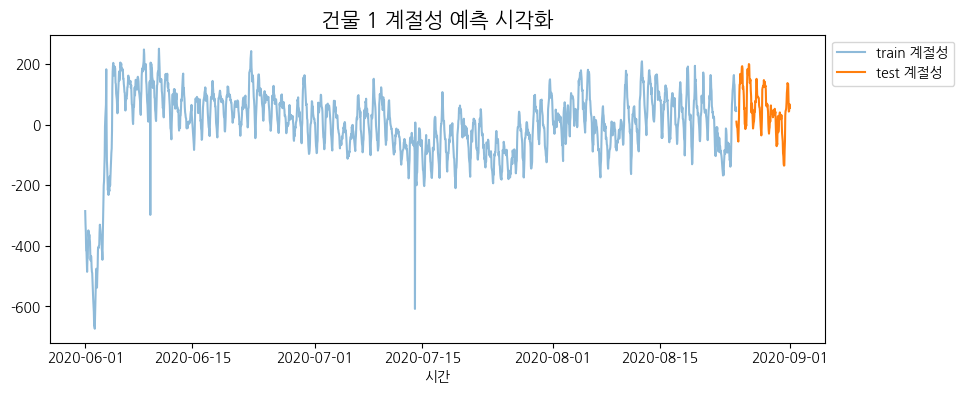

In [163]:
fig = plt.figure(figsize = (10 ,4))
plt.title('건물 1 계절성 예측 시각화', size = 15)
sns.lineplot(x = train_x['시간'], y = xgb_train, alpha=0.5, label = 'train 계절성')
sns.lineplot(x = test_x['시간'], y = xgb_test, label = 'test 계절성')

plt.xticks()
plt.legend(bbox_to_anchor=(1.0, 1.0), loc='upper left')
plt.show()

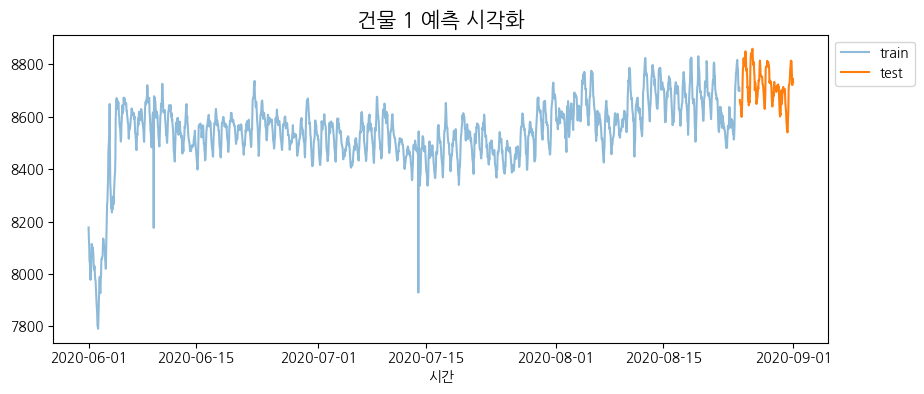

In [164]:
total_train = trend_train + xgb_train
total_test = trend_test + xgb_test

fig = plt.figure(figsize = (10 ,4))
plt.title('건물 1 예측 시각화', size = 15)
sns.lineplot(x = train_x['시간'], y = total_train, alpha=0.5, label = 'train')
sns.lineplot(x = test_x['시간'], y = total_test, label = 'test')

plt.xticks()
plt.legend(bbox_to_anchor=(1.0, 1.0), loc='upper left')
plt.show()

#### 전체 건물에 대해서

In [1]:
pred_trend_seasonal = []

for i in tqdm(range(1,61)):
    train_y = pd.DataFrame(train[train['건물번호']==i]['전력사용량'])
    train_x = train[train['건물번호']==i].drop(columns=['전력사용량', 'date','건물번호'])
    test_x = test[test['건물번호']==i].drop(columns=['date', '건물번호'])
    train_x = train_x
    y_train, y_valid, x_train, x_valid = temporal_train_test_split(y = train_y, X = train_x, test_size = 168) # 24시간*7일 = 168

    parm = {
        'learning_rate' : xgb_params.iloc[1-1,0],
        'max_depth' : xgb_params.iloc[1-1,1],
        'subsample' : xgb_params.iloc[1-1,2]
    }
    xgb = XGBRegressor(random_state=42, **parm)

    xgb = xgb.fit(x_train.drop('시간',axis=1), y_train)
    g1 = xgb.predict(x_train.drop('시간',axis=1))
    g2 = xgb.predict(x_valid.drop('시간',axis=1))
    xgb = xgb.fit(train_x.drop('시간',axis=1), train_y)
    g3 = xgb.predict(test_x.drop('시간',axis=1))

    # 추세 예측(linear model)
    dp = DeterministicProcess(
                              index = train_x.index, 
                              constant = True,  
                              order = 2, 
                              drop = True,      
                              )
    
    X = dp.in_sample()
    lm = LinearRegression(fit_intercept=False)
    lm.fit(X, train_y)

    test_const=[]
    test_trend=[]
    test_trend_squared=[]
    
    test_const = [1 for i in range(test_x.shape[0])]
    test_trend = np.arange(X['trend'].max(), X['trend'].max()+test_x.shape[0])
    test_trend_squared = [i**2 for i in test_trend]
    X_ = pd.DataFrame([test_const, test_trend, test_trend_squared]).T
    X_.columns = ['const', 'trend', 'trend_squared']
    X_.index = x_valid.index

    trend_train = lm.predict(X)
    trend_test = lm.predict(X_)

    arr_2d1 = np.array(trend_train)
    arr_2d2 = np.array(trend_test)

    # 2차원 배열을 1차원 배열로 변환
    trend_train = arr_2d1.flatten()
    trend_test = arr_2d2.flatten()

    # 계절성 예측(xgb)
    train_y_delta = y_train['전력사용량'] - trend_train[:1872]
    test_y_delta = y_valid['전력사용량'] - trend_train[1872:]


    xgb.fit(x_train.drop('시간', axis=1), train_y_delta)

    xgb_train = xgb.predict(train_x.drop('시간', axis=1))
    xgb_test = xgb.predict(test_x.drop('시간', axis=1))

    # 추세 + 계절성
    total_train = trend_train + xgb_train
    total_test = trend_test + xgb_test

    pred_trend_seasonal.append(total_test)

    fig = plt.figure(figsize = (10 ,4))
    plt.title(f'건물 {i} 예측 시각화', size = 15)
    sns.lineplot(x = train_x['시간'], y = total_train, alpha=0.5, label = 'train')
    sns.lineplot(x = test_x['시간'], y = total_test, label = 'test')

    plt.xticks()
    plt.legend(bbox_to_anchor=(1.0, 1.0), loc='upper left')
    plt.show()



NameError: name 'tqdm' is not defined

In [185]:
len(pred_trend_seasonal[0])

168

In [187]:
arr_2d = np.array(pred_trend_seasonal)

# 2차원 배열을 1차원 배열로 변환
pred_trend_seasonal = arr_2d.flatten()

10080

In [188]:
sub['answer'] = pred_trend_seasonal

sub.to_csv('submit_trend_seasonal.csv', index=False)